In [1]:
import os
os.environ['JAX_PLATFORM_NAME'] = 'cpu'
from inference.spatial_compartmental.viz import  posterior_comparison, post_prediction_comparison
import jax
jax.config.update("jax_enable_x64", True) #64 bit precision calcs
jax.config.update('jax_platform_name', 'cpu')
import jax.numpy as jnp
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import gc
from abm.spatial_compartmental.si import get_abm
from abm.spatial_compartmental.utils import Neighbourhood, calc_start_n_initial
import pickle

/home/tim/Documents/thesis/dgs4abm/.venv/lib64/python3.12/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [2]:
print(f"JAX devices: {jax.devices()}")

JAX devices: [CpuDevice(id=0)]


In [3]:
from matplotlib.lines import Line2D
from matplotlib.collections import PathCollection
from matplotlib.container import BarContainer
from matplotlib.patches import Rectangle
import matplotlib.patches as mpatches

def get_color_by_label(ax, label):
    """
    Finds a plotted element on the axes by its label and returns its color.

    Args:
        ax (matplotlib.axes.Axes): The axes object containing the plot.
        label (str): The label of the element to find.

    Returns:
        tuple or str or None: The color (often RGBA tuple) of the element,
                               or None if no element with that label is found.
    """
    # Check lines (plot)
    for line in ax.lines:
        if line.get_label() == label:
            return line.get_color() # Returns color format used (e.g., 'red', '#FF0000', (1,0,0,1))

    # Check containers (common for bar plots)
    for container in ax.containers:
        if isinstance(container, BarContainer) and container.get_label() == label:
            # Get color from the first patch in the container
            if container.patches:
                return container.patches[0].get_facecolor() # Returns RGBA tuple

    # Check collections (scatter)
    for collection in ax.collections:
        if collection.get_label() == label:
            # Facecolor is often an array, even for single color. Take the first.
            colors = collection.get_facecolor()
            if colors.size > 0:
                return colors[0] # Returns RGBA tuple array, take first row
            else: # May happen if color is 'none' or similar
                 edge_colors = collection.get_edgecolor()
                 if edge_colors.size > 0:
                     return edge_colors[0]


    # Check individual patches (less common for labeled elements but possible)
    for patch in ax.patches:
         # Only consider patches that are direct children (not part of a container already checked)
        if isinstance(patch, Rectangle) and patch.get_label() == label:
             # Check if it belongs to a container; if so, we likely handled it above
             if patch.get_container() is None or patch.get_container().get_label() != label:
                  return patch.get_facecolor()

    # Label not found
    print(f"Warning: No element found with label '{label}'")
    return None

In [4]:
#NOTE: Requires 64-bit precision
def calculate_NLPD(key, abm_conf, posterior, n_subsample,grid_size, num_steps):
    key, subkey = jax.random.split(key)

    data_for_kde = jax.random.choice(
    subkey,
    posterior[abm_conf]['obs'],
    (n_subsample,)).astype(jnp.float64).T

    key, subkey = jax.random.split(key)

    data_for_kde += 1e-6*jax.random.normal(subkey, (num_steps,n_subsample)) #Add jitter


    kde_est =jax.scipy.stats.gaussian_kde(data_for_kde)

    abm = get_abm(Neighbourhood.DIAGONAL, vmap=True)
    ground_truth_observations = abm(jax.random.split(key,n_subsample), 
                                grid_size, num_steps,abm_conf[0],
                                calc_start_n_initial(abm_conf[1],grid_size))[-1][:,:-1]
    
    log_densities = kde_est.logpdf(ground_truth_observations.astype(jnp.float64).T)
    averaged_nlpd = -np.mean(log_densities)
    if jnp.isnan(averaged_nlpd).any():
        raise ValueError(f'NLPD for {abm_conf} contains NaNs')
    return averaged_nlpd


def calculate_metrics(abm_posterior, surrogates_posterior, grid_size, num_steps, n_subsample=1000):
    # ESS per sec
    abm_ess_per_sec = jnp.array([abm_posterior[abm_conf]['mcmc_summary'][0]['n_eff']/abm_posterior[abm_conf]['mcmc_time'] for abm_conf in abm_posterior.keys()])
    mcmlp_ess_per_sec = jnp.array([surrogates_posterior['mcmlp'][abm_conf]['mcmc_summary'][0]['n_eff']/surrogates_posterior['mcmlp'][abm_conf]['mcmc_time'] for abm_conf in abm_posterior.keys()])
    priorcvae_ess_per_sec = jnp.array([surrogates_posterior['priorcvae'][abm_conf]['mcmc_summary'][0]['n_eff']/surrogates_posterior['priorcvae'][abm_conf]['mcmc_time'] for abm_conf in abm_posterior.keys()])

    #Posterior Means 
    abm_post_means = jnp.array([jnp.mean(abm_posterior[abm_conf]['posterior_samples']['p_infect']) for abm_conf in abm_posterior.keys()])
    mcmlp_post_means = jnp.array([jnp.mean(surrogates_posterior['mcmlp'][abm_conf]['posterior_samples']['p_infect']) for abm_conf in abm_posterior.keys()])
    priorcvae_post_means = jnp.array([jnp.mean(surrogates_posterior['priorcvae'][abm_conf]['posterior_samples']['p_infect']) for abm_conf in abm_posterior.keys()])

    #1-Wassersteins
    sorted_abm_dists = jnp.array([sorted(jax.random.choice(jax.random.fold_in(jax.random.PRNGKey(0), idx),
                                                       abm_posterior[abm_conf]['posterior_samples']['p_infect'],
                                                       (n_subsample,))) for idx,abm_conf in enumerate(abm_posterior.keys())])
    sorted_mcmlp_dists = jnp.array([sorted(jax.random.choice(jax.random.fold_in(jax.random.PRNGKey(1),idx), 
                                                         surrogates_posterior['mcmlp'][abm_conf]['posterior_samples']['p_infect'],
                                                         (n_subsample,))) for idx,abm_conf in enumerate(abm_posterior.keys())])
    sorted_priorcvae_dists = jnp.array([sorted(jax.random.choice(jax.random.fold_in(jax.random.PRNGKey(2),idx), 
                                                         surrogates_posterior['priorcvae'][abm_conf]['posterior_samples']['p_infect'],
                                                         (n_subsample,))) for idx,abm_conf in enumerate(abm_posterior.keys())])
    
    mcmlp_1_wassersteins = 1/n_subsample * jnp.sum(jnp.abs(sorted_abm_dists-sorted_mcmlp_dists),axis=1)
    priorcvae_1_wassersteins = 1/n_subsample * jnp.sum(jnp.abs(sorted_abm_dists-sorted_priorcvae_dists),axis=1)


    #NLPDs
    abm_nlpds = jnp.array([calculate_NLPD(jax.random.fold_in(jax.random.PRNGKey(0), idx),abm_conf, abm_posterior, 
                                          n_subsample, grid_size, num_steps)  for idx, abm_conf  in enumerate(abm_posterior.keys())])
    mcmlp_nlpds = jnp.array([calculate_NLPD(jax.random.fold_in(jax.random.PRNGKey(1), idx),abm_conf, surrogates_posterior['mcmlp'], 
                                          n_subsample, grid_size, num_steps)  for idx, abm_conf  in enumerate(abm_posterior.keys())])
    priorcvae_nlpds = jnp.array([calculate_NLPD(jax.random.fold_in(jax.random.PRNGKey(2), idx),abm_conf, surrogates_posterior['priorcvae'], 
                                          n_subsample, grid_size, num_steps)  for idx, abm_conf  in enumerate(abm_posterior.keys())])
    
    return {
        'ESS_per_sec':{
            'abm':abm_ess_per_sec,
            'mcmlp':mcmlp_ess_per_sec,
            'priorcvae':priorcvae_ess_per_sec,
        },
        'posterior_mean':{
            'abm':abm_post_means,
            'mcmlp':mcmlp_post_means,
            'priorcvae':priorcvae_post_means
        },
        '1_wasserstein':{
            'mcmlp':mcmlp_1_wassersteins,
            'priorcvae':priorcvae_1_wassersteins,
        },
        'NLPD':{
            'abm':abm_nlpds,
            'mcmlp':mcmlp_nlpds,
            'priorcvae':priorcvae_nlpds,
        },
    }






## Grid 10 and Steps 10

In [ ]:
g10_s10_output_dir = "inference_outputs/2025-04-25/21-34-38/"

with open(f"{g10_s10_output_dir}/prior_predictions.npy", "rb") as f:
    prior_predictions = jnp.load(f, allow_pickle=True).item()
with open(f"{g10_s10_output_dir}/abm_posterior.npy", "rb") as f:
    abm_posterior = jnp.load(f, allow_pickle=True).item()
with open(f"{g10_s10_output_dir}/surrogates_posterior.npy", "rb") as f:
    surrogates_posterior = jnp.load(f, allow_pickle=True).item()
with open(f"{g10_s10_output_dir}/data.npy", "rb") as f:
    data = jnp.load(f, allow_pickle=True).item()

g10_s10_abm_times = [x['mcmc_time'] for x in abm_posterior.values()]
g10_s10_mcmlp_times = [x['mcmc_time'] for x in surrogates_posterior['mcmlp'].values()]
g10_s10_priorcvae_times = [x['mcmc_time'] for x in surrogates_posterior['priorcvae'].values()]


In [5]:
for abm_conf in abm_posterior.keys():
    print(f'================{abm_conf}=======================')
    ok=True
    abm_rhat = abm_posterior[abm_conf]["mcmc_summary"][0]['r_hat']
    mcmlp_rhat = surrogates_posterior["mcmlp"][abm_conf]["mcmc_summary"][0]["r_hat"]
    priorcvae_rhat = surrogates_posterior["priorcvae"][abm_conf]["mcmc_summary"][0]["r_hat"]
    
    abm_ess = abm_posterior[abm_conf]["mcmc_summary"][0]['n_eff']
    mcmlp_ess = surrogates_posterior["mcmlp"][abm_conf]["mcmc_summary"][0]["n_eff"]
    priorcvae_ess = surrogates_posterior["priorcvae"][abm_conf]["mcmc_summary"][0]["n_eff"]

    if abm_rhat>=1.1: print(f'BAD ABM MCMC r_hat: {abm_rhat:.3f}'); ok=False
    if mcmlp_rhat>=1.1: print(f'BAD MCMLP MCMC r_hat: {mcmlp_rhat:.3f}'); ok=False
    if priorcvae_rhat>=1.1: print(f'BAD PriorCVAE MCMC r_hat: {priorcvae_rhat:.3f}');ok=False

    if abm_ess<400: print(f'BAD ABM MCMC ESS: {abm_ess:.3f}'); ok=False
    if mcmlp_ess<400: print(f'BAD MCMLP MCMC ESS: {mcmlp_ess:.3f}'); ok=False
    if priorcvae_ess<400: print(f'BAD PriorCVAE MCMC ESS: {priorcvae_ess:.3f}');ok=False
    if ok:
        print('All r_hats and ess ok')

================(0.01, 0.01)=======================
All r_hats and ess ok
================(0.01, 0.05)=======================
All r_hats and ess ok
================(0.01, 0.1)=======================
All r_hats and ess ok
================(0.01, 0.2)=======================
BAD ABM MCMC ESS: 59.492
================(0.01, 0.3)=======================
All r_hats and ess ok
================(0.01, 0.4)=======================
All r_hats and ess ok
================(0.01, 0.5)=======================
All r_hats and ess ok
================(0.01, 0.6)=======================
All r_hats and ess ok
================(0.01, 0.7)=======================
BAD ABM MCMC ESS: 43.639
================(0.01, 0.8)=======================
All r_hats and ess ok
================(0.05, 0.01)=======================
All r_hats and ess ok
================(0.05, 0.05)=======================
All r_hats and ess ok
================(0.05, 0.1)=======================
All r_hats and ess ok
================(0.05, 0.2)==============

In [6]:
g10_s10_metrics  = calculate_metrics(abm_posterior, surrogates_posterior, grid_size=10, num_steps=10, n_subsample=1000)

In [7]:
with open('../04_24_viz/g10_s10_metrics.pkl','wb') as f:
    pickle.dump(g10_s10_metrics,f)

In [ ]:

# abm_ess_per_sec = jnp.array([abm_posterior[abm_conf]['mcmc_summary'][0]['n_eff']/abm_posterior[abm_conf]['mcmc_time'] for abm_conf in abm_posterior.keys()])
# mcmlp_ess_per_sec = jnp.array([surrogates_posterior['mcmlp'][abm_conf]['mcmc_summary'][0]['n_eff']/surrogates_posterior['mcmlp'][abm_conf]['mcmc_time'] for abm_conf in abm_posterior.keys()])
# priorcvae_ess_per_sec = jnp.array([surrogates_posterior['priorcvae'][abm_conf]['mcmc_summary'][0]['n_eff']/surrogates_posterior['priorcvae'][abm_conf]['mcmc_time'] for abm_conf in abm_posterior.keys()])
# print(f'ABM - ESS per sec {jnp.mean(abm_ess_per_sec):.2f} +- {jnp.std(abm_ess_per_sec):.2f}')
# print(f'MCMLP - ESS per sec {jnp.mean(mcmlp_ess_per_sec):.2f} +- {jnp.std(mcmlp_ess_per_sec):.2f}')
# print(f'PriorCVAE - ESS per sec {jnp.mean(priorcvae_ess_per_sec):.2f} +- {jnp.std(priorcvae_ess_per_sec):.2f}')



# print(50*"=")

# abm_post_means = jnp.array([jnp.mean(abm_posterior[abm_conf]['posterior_samples']['p_infect']) for abm_conf in abm_posterior.keys()])
# mcmlp_post_means = jnp.array([jnp.mean(surrogates_posterior['mcmlp'][abm_conf]['posterior_samples']['p_infect']) for abm_conf in abm_posterior.keys()])
# priorcvae_post_means = jnp.array([jnp.mean(surrogates_posterior['priorcvae'][abm_conf]['posterior_samples']['p_infect']) for abm_conf in abm_posterior.keys()])

# print(f'MCMLP - Posterior Mean MSE {jnp.mean(jnp.square(abm_post_means-mcmlp_post_means)):.2f}')
# print(f'PriorCVAE - Posterior Mean MSE {jnp.mean(jnp.square(abm_post_means-priorcvae_post_means)):.3f}')

# print(50*'=')
# # NOTE: Redo keys
# sorted_abm_dists = jnp.array([sorted(jax.random.choice(jax.random.fold_in(jax.random.PRNGKey(0), idx),
#                                                        abm_posterior[abm_conf]['posterior_samples']['p_infect'],
#                                                        (1000,))) for idx,abm_conf in enumerate(abm_posterior.keys())])
# sorted_mcmlp_dists = jnp.array([sorted(jax.random.choice(jax.random.fold_in(jax.random.PRNGKey(1),idx), 
#                                                          surrogates_posterior['mcmlp'][abm_conf]['posterior_samples']['p_infect'],
#                                                          (1000,))) for idx,abm_conf in enumerate(abm_posterior.keys())])
# sorted_priorcvae_dists = jnp.array([sorted(jax.random.choice(jax.random.fold_in(jax.random.PRNGKey(2),idx), 
#                                                          surrogates_posterior['priorcvae'][abm_conf]['posterior_samples']['p_infect'],
#                                                          (1000,))) for idx,abm_conf in enumerate(abm_posterior.keys())])
# print(f'MCMLP - 1-Wassterstein: {1e-3*jnp.sum(jnp.abs(sorted_abm_dists-sorted_mcmlp_dists)):.2f}')
# print(f'PriorCVAE - 1-Wassterstein: {1e-3*jnp.sum(jnp.abs(sorted_abm_dists-sorted_priorcvae_dists)):.2f}')

<>:49: SyntaxWarning: invalid escape sequence '\m'
<>:49: SyntaxWarning: invalid escape sequence '\m'
/tmp/ipykernel_169438/2014008250.py:49: SyntaxWarning: invalid escape sequence '\m'
  axarr[idx, 0].set_ylabel(f'$p_{{\mathrm{{infect}}}}$ = {p_infect}', rotation=90, labelpad=20, va='center',fontsize=14)


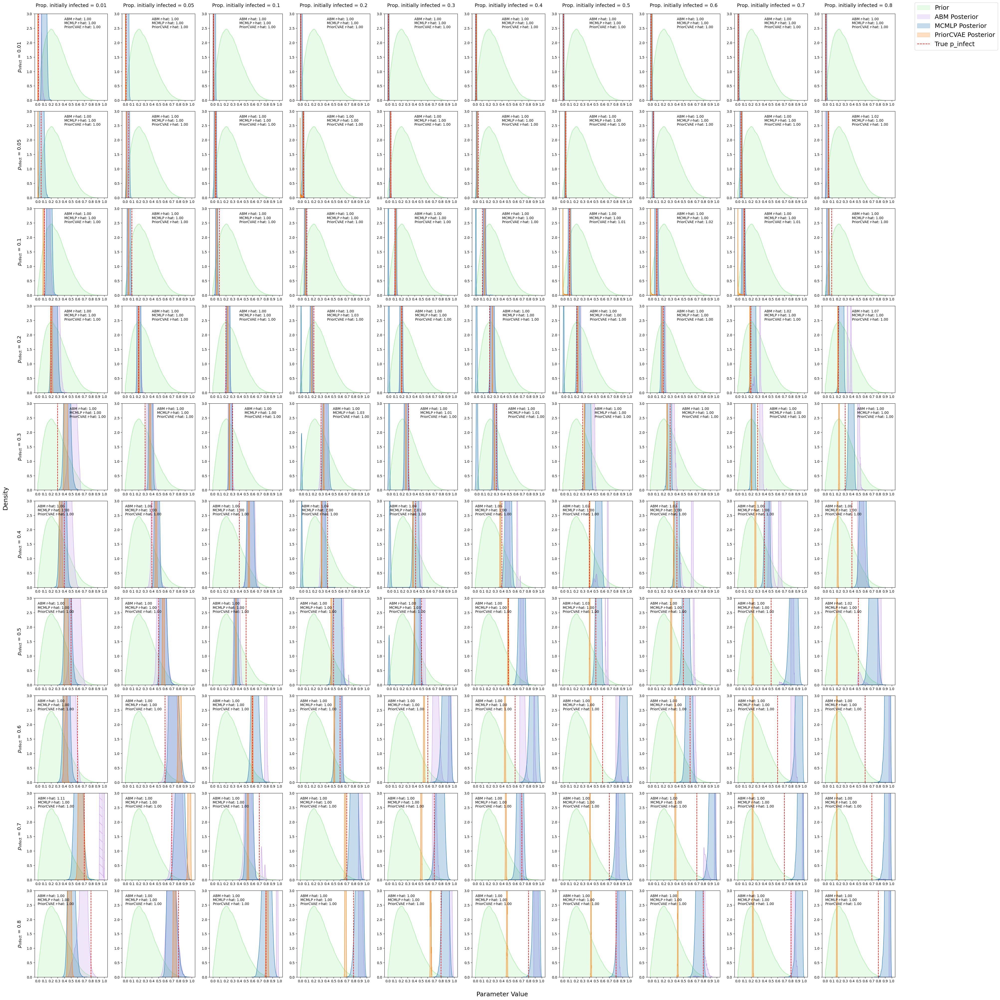

In [ ]:
fig, axarr = plt.subplots(10,10,figsize=(40, 40))

for row,p_inf in enumerate([0.01, 0.05, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8]):
    for col,prop_init_infected in enumerate([0.01, 0.05, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8]):
        rhats={'abm':abm_posterior[(p_inf, prop_init_infected)]["mcmc_summary"][0]['r_hat'],
                'mcmlp':surrogates_posterior['mcmlp'][(p_inf, prop_init_infected)]["mcmc_summary"][0]['r_hat'],
                'priorcvae':surrogates_posterior['priorcvae'][(p_inf, prop_init_infected)]["mcmc_summary"][0]['r_hat']}
        axarr[row,col] = posterior_comparison(
                axarr[row,col],
                (p_inf, prop_init_infected),
                abm_posterior,
                surrogates_posterior,
                (p_inf, "p_infect"),
                rhats,
                prior_predictions,
                xlim=(None, 1.05),
                ylim=(0, 3),
                logdensities=False,
                show_legend=False,
                set_x_and_ylabels=False,
            )
        
        surrogate_r_hat_string = '\n'.join([f"{disp_name} r-hat: {rhats[surrogate_name]:.2f}" for surrogate_name,disp_name in zip(['mcmlp','priorcvae'], 
                                                                                                                                               ['MCMLP', 'PriorCVAE'])])
        if row<=3:
            text_x=0.4
        elif row==4:
            text_x=0.48
        else:
            text_x=0.00
        axarr[row,col].annotate(
            f"ABM r-hat: {rhats['abm']:.2f}\n"+surrogate_r_hat_string,
            (text_x,2.5),
            )



legend_handles=[]
for color in [get_color_by_label(axarr[0,0],'Prior'), 
            get_color_by_label(axarr[0,0],'ABM Posterior'),
            get_color_by_label(axarr[0,0],'mcmlp Posterior'),
            get_color_by_label(axarr[0,0],'priorcvae Posterior')]:
    legend_handle=mpatches.Patch(color=color)
    legend_handles.append(legend_handle)
legend_handles.append(Line2D([0],[0],color='red', linestyle='--'))

for idx,p_infect in enumerate([0.01, 0.05, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8]):
    axarr[idx, 0].set_ylabel(f'$p_{{\mathrm{{infect}}}}$ = {p_infect}', rotation=90, labelpad=20, va='center',fontsize=14)

for jdx, initial_infected in enumerate([0.01, 0.05, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8]):
    axarr[0,jdx].set_xlabel(f"Prop. initially infected = {initial_infected}",labelpad=20,fontsize=14)
    axarr[0, jdx].xaxis.set_label_position('top') 


fig.legend(handles=legend_handles, labels=['Prior', 'ABM Posterior', 'MCMLP Posterior', 'PriorCVAE Posterior', 'True p_infect'],
           loc='upper right', bbox_to_anchor=(1, 1), bbox_transform=fig.transFigure,fontsize=18)
fig.supylabel('Density',fontsize=18,x=-0.001)
fig.supxlabel('Parameter Value',fontsize=18,y=-0.001)
# fig.suptitle('Comparison of ABM and surrogate posteriors across 100 combinations of prob_infect and initial_infected\nGrid Size 10 and Number of Steps 10', 
#              y=1.01,fontsize=20)
plt.tight_layout(rect=[0, 0, 0.90, 1],h_pad=1,w_pad=1)
fig.savefig('../04_24_viz/g10_s10_posteriors.pdf')

plt.show()

<>:59: SyntaxWarning: invalid escape sequence '\m'
<>:59: SyntaxWarning: invalid escape sequence '\m'
/tmp/ipykernel_169438/2110910958.py:59: SyntaxWarning: invalid escape sequence '\m'
  axarr[idx, 0].set_ylabel(f'$p_{{\mathrm{{infect}}}}$ = {p_infect}', rotation=90, labelpad=20, va='center',fontsize=14)


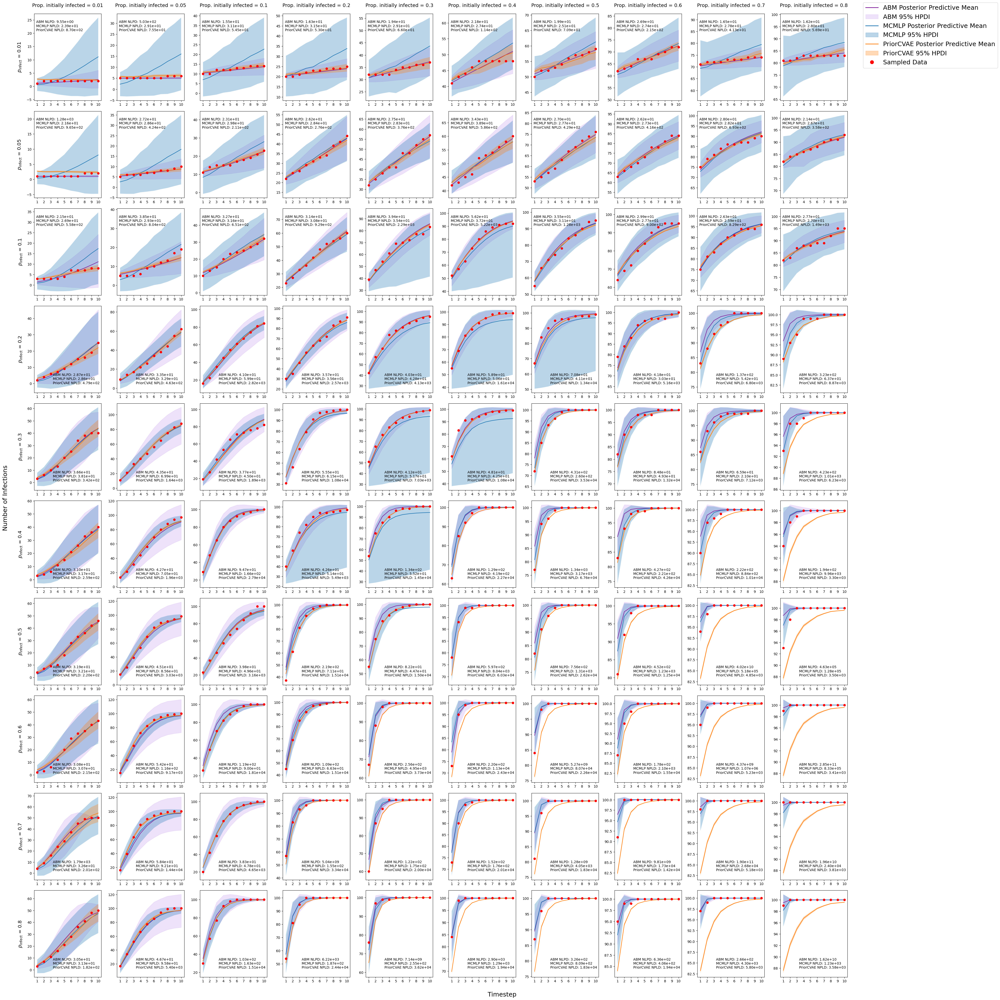

In [19]:
fig, axarr = plt.subplots(10,10,figsize=(40, 40))

nlpd_dict = {
    'abm':{k:v for k,v in zip(abm_posterior.keys(),g10_s10_metrics['NLPD']['abm'])},
    'mcmlp': {k:v for k,v in zip(abm_posterior.keys(),g10_s10_metrics['NLPD']['mcmlp'])},
    'priorcvae': {k:v for k,v in zip(abm_posterior.keys(),g10_s10_metrics['NLPD']['priorcvae'])},
}


for row,p_inf in enumerate([0.01, 0.05, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8]):
    for col,prop_init_infected in enumerate([0.01, 0.05, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8]):
        axarr[row,col] = post_prediction_comparison(
            axarr[row,col],
            (p_inf,prop_init_infected),
            abm_posterior,
            surrogates_posterior,
            data,
            None, hpdi_alpha=0.3,
            show_legend=False,
            set_x_and_ylabels=False,
        ) 
        axarr[row,col].set_xticks(jnp.arange(0,10),jnp.arange(1,11))
        
        surrogate_nlpd_string = '\n'.join([f"{disp_name} NPLD: {nlpd_dict[surrogate_name][(p_inf,prop_init_infected)]:.2e}" for surrogate_name,disp_name in zip(['mcmlp','priorcvae'], 
                                                                                                                                               ['MCMLP', 'PriorCVAE'])])
        if row<=2:
            text_x=0.03
            text_y=0.8
        else:
            text_x=0.28
            text_y =0.1
        axarr[row,col].annotate(
            f"ABM NLPD: {nlpd_dict['abm'][(p_inf,prop_init_infected)]:.2e}\n"+surrogate_nlpd_string,
            (text_x,text_y),
            xycoords='axes fraction'
            )
        



legend_handles=[]
for idx,color in enumerate([get_color_by_label(axarr[0,0],'ABM Posterior Predictive Mean'), 
            get_color_by_label(axarr[0,0],'ABM 95% HPDI'),
            get_color_by_label(axarr[0,0],'mcmlp Posterior Predictive Mean'),
            get_color_by_label(axarr[0,0],'mcmlp 95% HPDI'),
            get_color_by_label(axarr[0,0],'priorcvae Posterior Predictive Mean'),
            get_color_by_label(axarr[0,0],'priorcvae 95% HPDI')]):
    if idx%2==0:
        legend_handle = Line2D([0],[0],color=color,
                           linestyle='-',linewidth=2)
    else:
        legend_handle=mpatches.Patch(color=color)
    legend_handles.append(legend_handle)
legend_handles.append(Line2D([],[],color='None', marker='o',linestyle='None',markersize=10,
                             markerfacecolor='red',markeredgecolor='red'))


for idx,p_infect in enumerate([0.01, 0.05, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8]):
    axarr[idx, 0].set_ylabel(f'$p_{{\mathrm{{infect}}}}$ = {p_infect}', rotation=90, labelpad=20, va='center',fontsize=14)

for jdx, initial_infected in enumerate([0.01, 0.05, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8]):
    axarr[0,jdx].set_xlabel(f"Prop. initially infected = {initial_infected}",labelpad=20,fontsize=14)
    axarr[0, jdx].xaxis.set_label_position('top') 


fig.legend(handles=legend_handles, labels=['ABM Posterior Predictive Mean', 
                                           'ABM 95% HPDI', 
                                           'MCMLP Posterior Predictive Mean', 
                                           'MCMLP 95% HPDI',
                                           'PriorCVAE Posterior Predictive Mean', 
                                           'PriorCVAE 95% HPDI',
                                           'Sampled Data'],
           loc='upper right', bbox_to_anchor=(1, 1), bbox_transform=fig.transFigure,fontsize=18)
fig.supylabel('Number of Infections',fontsize=18,x=-0.001)
fig.supxlabel('Timestep',fontsize=18,y=-0.001)
# fig.suptitle('Comparison of ABM and surrogate posterior predictions across 100 combinations of prob_infect and initial_infected\nGrid Size 10 and Num Steps 10', 
#              y=1.01,fontsize=20)
plt.tight_layout(rect=[0, 0, 0.85, 1],h_pad=1,w_pad=1)
fig.savefig('../04_24_viz/g10_s10_preds.pdf')
plt.show()

In [6]:
del abm_posterior
del surrogates_posterior
del prior_predictions
del data
gc.collect()

60

## Grid Size 10 and Steps 20

In [ ]:
g10_s20_output_dir = "../inference_outputs/2025-04-24/19-01-47/"

with open(f"{g10_s20_output_dir}/prior_predictions.npy", "rb") as f:
    prior_predictions = jnp.load(f, allow_pickle=True).item()
with open(f"{g10_s20_output_dir}/abm_posterior.npy", "rb") as f:
    abm_posterior = jnp.load(f, allow_pickle=True).item()
with open(f"{g10_s20_output_dir}/surrogates_posterior.npy", "rb") as f:
    surrogates_posterior = jnp.load(f, allow_pickle=True).item()
with open(f"{g10_s20_output_dir}/data.npy", "rb") as f:
    data = jnp.load(f, allow_pickle=True).item()

g10_s20_abm_times = [x['mcmc_time'] for x in abm_posterior.values()]
g10_s20_mcmlp_times = [x['mcmc_time'] for x in surrogates_posterior['mcmlp'].values()]
g10_s20_priorcvae_times = [x['mcmc_time'] for x in surrogates_posterior['priorcvae'].values()]


In [5]:
g10_s20_metrics = calculate_metrics(abm_posterior, surrogates_posterior, grid_size=10, 
                                    num_steps=20, n_subsample=1000)

In [6]:
with open('../04_24_viz/g10_s20_metrics.pkl','wb') as f:
    pickle.dump(g10_s20_metrics,f)

In [ ]:
print(np.mean(g10_s20_abm_times), np.std(g10_s20_abm_times))
print(np.mean(g10_s20_mcmlp_times), np.std(g10_s20_mcmlp_times))
print(np.mean(g10_s20_priorcvae_times), np.std(g10_s20_priorcvae_times))

In [ ]:

abm_ess_per_sec = jnp.array([abm_posterior[abm_conf]['mcmc_summary'][0]['n_eff']/abm_posterior[abm_conf]['mcmc_time'] for abm_conf in abm_posterior.keys()])
mcmlp_ess_per_sec = jnp.array([surrogates_posterior['mcmlp'][abm_conf]['mcmc_summary'][0]['n_eff']/surrogates_posterior['mcmlp'][abm_conf]['mcmc_time'] for abm_conf in abm_posterior.keys()])
priorcvae_ess_per_sec = jnp.array([surrogates_posterior['priorcvae'][abm_conf]['mcmc_summary'][0]['n_eff']/surrogates_posterior['priorcvae'][abm_conf]['mcmc_time'] for abm_conf in abm_posterior.keys()])
print(f'ABM - ESS per sec {jnp.mean(abm_ess_per_sec):.2f} +- {jnp.std(abm_ess_per_sec):.2f}')
print(f'MCMLP - ESS per sec {jnp.mean(mcmlp_ess_per_sec):.2f} +- {jnp.std(mcmlp_ess_per_sec):.2f}')
print(f'PriorCVAE - ESS per sec {jnp.mean(priorcvae_ess_per_sec):.2f} +- {jnp.std(priorcvae_ess_per_sec):.2f}')

print(50*"=")

abm_post_means = jnp.array([jnp.mean(abm_posterior[abm_conf]['posterior_samples']['p_infect']) for abm_conf in abm_posterior.keys()])
mcmlp_post_means = jnp.array([jnp.mean(surrogates_posterior['mcmlp'][abm_conf]['posterior_samples']['p_infect']) for abm_conf in abm_posterior.keys()])
priorcvae_post_means = jnp.array([jnp.mean(surrogates_posterior['priorcvae'][abm_conf]['posterior_samples']['p_infect']) for abm_conf in abm_posterior.keys()])

print(f'MCMLP - Posterior Mean MSE {jnp.mean(jnp.square(abm_post_means-mcmlp_post_means)):.2f}')
print(f'PriorCVAE - Posterior Mean MSE {jnp.mean(jnp.square(abm_post_means-priorcvae_post_means)):.3f}')

print(50*'=')
# NOTE: Redo keys
sorted_abm_dists = jnp.array([sorted(jax.random.choice(jax.random.PRNGKey(0),
                                                       abm_posterior[abm_conf]['posterior_samples']['p_infect'],
                                                       (1000,))) for abm_conf in abm_posterior.keys()])
sorted_mcmlp_dists = jnp.array([sorted(jax.random.choice(jax.random.PRNGKey(1), 
                                                         surrogates_posterior['mcmlp'][abm_conf]['posterior_samples']['p_infect'],
                                                         (1000,))) for abm_conf in abm_posterior.keys()])
sorted_priorcvae_dists = jnp.array([sorted(jax.random.choice(jax.random.PRNGKey(2), 
                                                         surrogates_posterior['priorcvae'][abm_conf]['posterior_samples']['p_infect'],
                                                         (1000,))) for abm_conf in abm_posterior.keys()])
print(f'MCMLP - 1-Wassterstein: {1e-3*jnp.sum(jnp.abs(sorted_abm_dists-sorted_mcmlp_dists)):.2f}')
print(f'PriorCVAE - 1-Wassterstein: {1e-3*jnp.sum(jnp.abs(sorted_abm_dists-sorted_priorcvae_dists)):.2f}')

In [7]:
for abm_conf in abm_posterior.keys():
    print(f'================{abm_conf}=======================')
    ok=True
    abm_rhat = abm_posterior[abm_conf]["mcmc_summary"][0]['r_hat']
    mcmlp_rhat = surrogates_posterior["mcmlp"][abm_conf]["mcmc_summary"][0]["r_hat"]
    priorcvae_rhat = surrogates_posterior["priorcvae"][abm_conf]["mcmc_summary"][0]["r_hat"]
    
    abm_ess = abm_posterior[abm_conf]["mcmc_summary"][0]['n_eff']
    mcmlp_ess = surrogates_posterior["mcmlp"][abm_conf]["mcmc_summary"][0]["n_eff"]
    priorcvae_ess = surrogates_posterior["priorcvae"][abm_conf]["mcmc_summary"][0]["n_eff"]

    if abm_rhat>=1.1: print(f'BAD ABM MCMC r_hat: {abm_rhat:.3f}'); ok=False
    if mcmlp_rhat>=1.1: print(f'BAD MCMLP MCMC r_hat: {mcmlp_rhat:.3f}'); ok=False
    if priorcvae_rhat>=1.1: print(f'BAD PriorCVAE MCMC r_hat: {priorcvae_rhat:.3f}');ok=False

    if abm_ess<400: print(f'BAD ABM MCMC ESS: {abm_ess:.3f}'); ok=False
    if mcmlp_ess<400: print(f'BAD MCMLP MCMC ESS: {mcmlp_ess:.3f}'); ok=False
    if priorcvae_ess<400: print(f'BAD PriorCVAE MCMC ESS: {priorcvae_ess:.3f}');ok=False
    if ok:
        print('All r_hats and ess ok')

================(0.01, 0.01)=======================
All r_hats and ess ok
================(0.01, 0.05)=======================
All r_hats and ess ok
================(0.01, 0.1)=======================
BAD ABM MCMC ESS: 42.363
BAD PriorCVAE MCMC ESS: 33.065
================(0.01, 0.2)=======================
BAD ABM MCMC ESS: 49.171
BAD PriorCVAE MCMC ESS: 34.798
================(0.01, 0.3)=======================
All r_hats and ess ok
================(0.01, 0.4)=======================
BAD ABM MCMC ESS: 38.616
================(0.01, 0.5)=======================
BAD ABM MCMC ESS: 38.301
================(0.01, 0.6)=======================
BAD ABM MCMC ESS: 36.053
================(0.01, 0.7)=======================
BAD ABM MCMC ESS: 37.378
================(0.01, 0.8)=======================
BAD ABM MCMC ESS: 36.282
================(0.05, 0.01)=======================
All r_hats and ess ok
================(0.05, 0.05)=======================
All r_hats and ess ok
================(0.05, 0.1)==========

<>:46: SyntaxWarning: invalid escape sequence '\m'
<>:46: SyntaxWarning: invalid escape sequence '\m'
/tmp/ipykernel_176399/1712405968.py:46: SyntaxWarning: invalid escape sequence '\m'
  axarr[idx, 0].set_ylabel(f'$p_{{\mathrm{{infect}}}}$ = {p_infect}', rotation=90, labelpad=20, va='center',fontsize=14)


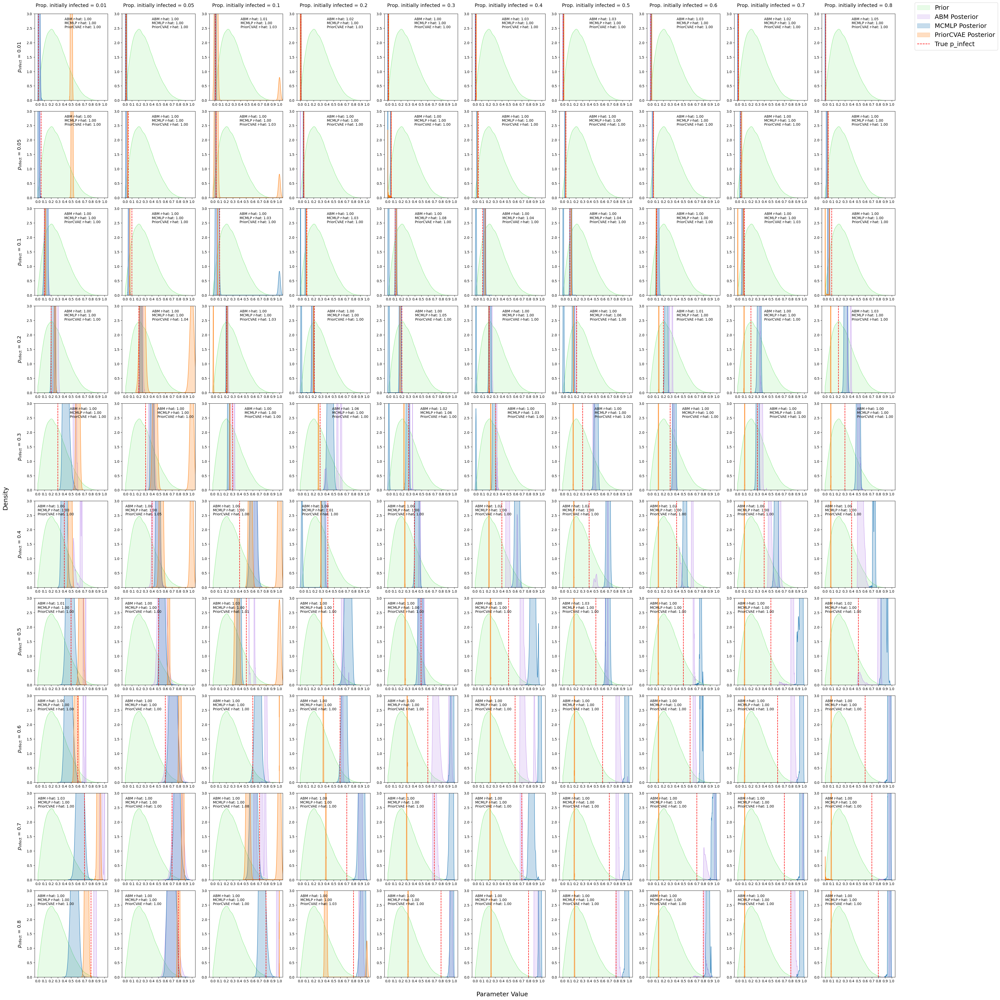

In [12]:
fig, axarr = plt.subplots(10,10,figsize=(40, 40))

for row,p_inf in enumerate([0.01, 0.05, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8]):
    for col,prop_init_infected in enumerate([0.01, 0.05, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8]):        
        rhats={'abm':abm_posterior[(p_inf, prop_init_infected)]["mcmc_summary"][0]['r_hat'],
                'mcmlp':surrogates_posterior['mcmlp'][(p_inf, prop_init_infected)]["mcmc_summary"][0]['r_hat'],
                'priorcvae':surrogates_posterior['priorcvae'][(p_inf, prop_init_infected)]["mcmc_summary"][0]['r_hat']}
        axarr[row,col] = posterior_comparison(
                axarr[row,col],
                (p_inf, prop_init_infected),
                abm_posterior,
                surrogates_posterior,
                (p_inf, "p_infect"),
                rhats,
                prior_predictions,
                xlim=(None, 1.05),
                ylim=(0, 3),
                logdensities=False,
                show_legend=False,
                set_x_and_ylabels=False,
            )

        surrogate_r_hat_string = '\n'.join([f"{disp_name} r-hat: {rhats[surrogate_name]:.2f}" for surrogate_name,disp_name in zip(['mcmlp','priorcvae'], 
                                                                                                                                               ['MCMLP', 'PriorCVAE'])])
        if row<=3:
            text_x=0.4
        elif row==4:
            text_x=0.48
        else:
            text_x=0.00
        axarr[row,col].annotate(
            f"ABM r-hat: {rhats['abm']:.2f}\n"+surrogate_r_hat_string,
            (text_x,2.5),
            )

legend_handles=[]
for color in [get_color_by_label(axarr[0,0],'Prior'), 
            get_color_by_label(axarr[0,0],'ABM Posterior'),
            get_color_by_label(axarr[0,0],'mcmlp Posterior'),
            get_color_by_label(axarr[0,0],'priorcvae Posterior')]:
    legend_handle=mpatches.Patch(color=color)
    legend_handles.append(legend_handle)
legend_handles.append(Line2D([0],[0],color='red', linestyle='--'))

for idx,p_infect in enumerate([0.01, 0.05, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8]):
    axarr[idx, 0].set_ylabel(f'$p_{{\mathrm{{infect}}}}$ = {p_infect}', rotation=90, labelpad=20, va='center',fontsize=14)

for jdx, initial_infected in enumerate([0.01, 0.05, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8]):
    axarr[0,jdx].set_xlabel(f"Prop. initially infected = {initial_infected}",labelpad=20,fontsize=14)
    axarr[0, jdx].xaxis.set_label_position('top') 


fig.legend(handles=legend_handles, labels=['Prior', 'ABM Posterior', 'MCMLP Posterior', 'PriorCVAE Posterior', 'True p_infect'],
           loc='upper right', bbox_to_anchor=(1, 1), bbox_transform=fig.transFigure,fontsize=18)
fig.supylabel('Density',fontsize=18,x=-0.001)
fig.supxlabel('Parameter Value',fontsize=18,y=-0.001)
#fig.suptitle('Comparison of ABM and surrogate posteriors across 100 combinations of prob_infect and initial_infected\nGrid Size 10 and Number of Steps 20', 
             #y=1.01,fontsize=20)
plt.tight_layout(rect=[0, 0, 0.90, 1],h_pad=1,w_pad=1)
fig.savefig('../04_24_viz/g10_s20_posteriors.pdf')

plt.show()

<>:54: SyntaxWarning: invalid escape sequence '\m'
<>:54: SyntaxWarning: invalid escape sequence '\m'
/tmp/ipykernel_176399/3732066969.py:54: SyntaxWarning: invalid escape sequence '\m'
  axarr[idx, 0].set_ylabel(f'$p_{{\mathrm{{infect}}}}$ = {p_infect}', rotation=90, labelpad=20, va='center',fontsize=14)


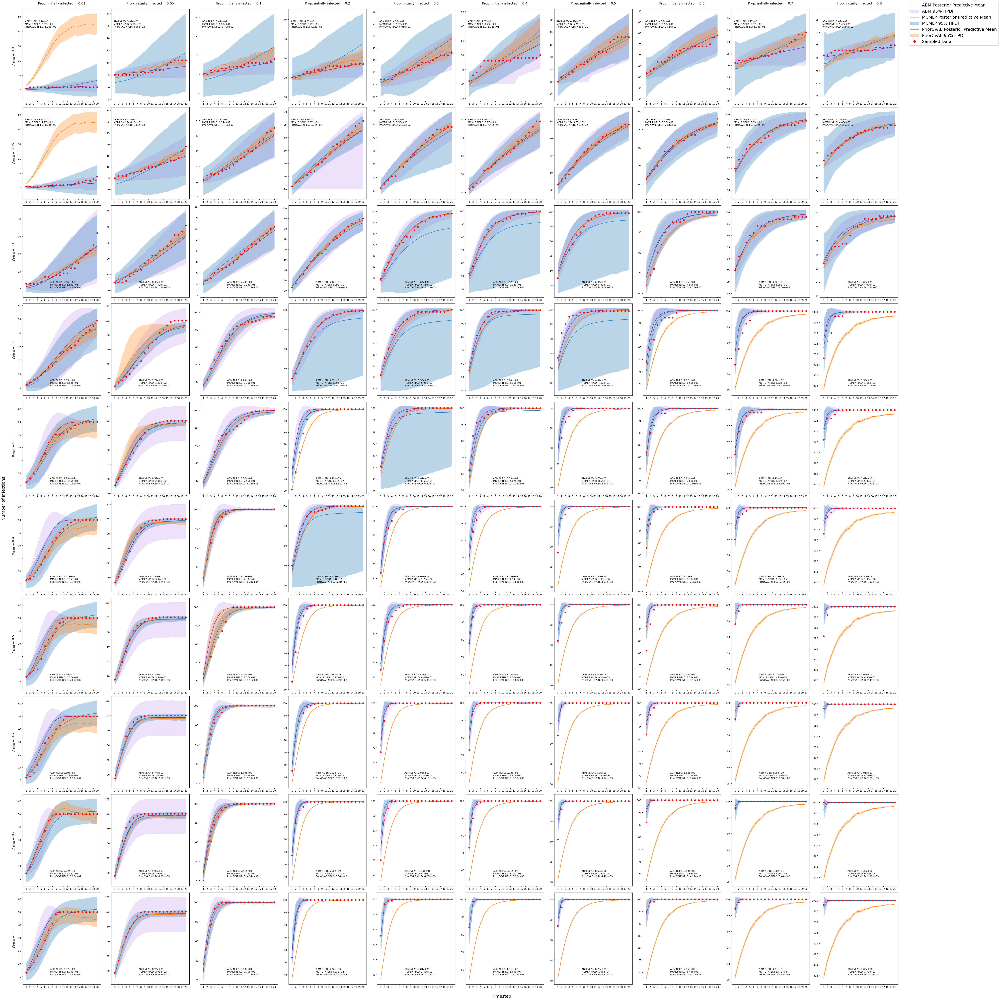

In [13]:
fig, axarr = plt.subplots(10,10,figsize=(60, 60))

nlpd_dict = {
    'abm':{k:v for k,v in zip(abm_posterior.keys(),g10_s20_metrics['NLPD']['abm'])},
    'mcmlp': {k:v for k,v in zip(abm_posterior.keys(),g10_s20_metrics['NLPD']['mcmlp'])},
    'priorcvae': {k:v for k,v in zip(abm_posterior.keys(),g10_s20_metrics['NLPD']['priorcvae'])},
}

for row,p_inf in enumerate([0.01, 0.05, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8]):
    for col,prop_init_infected in enumerate([0.01, 0.05, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8]):
        axarr[row,col] =post_prediction_comparison(
            axarr[row,col],
            (p_inf,prop_init_infected),
            abm_posterior,
            surrogates_posterior,
            data,
            None, hpdi_alpha=0.3,
            show_legend=False,
            set_x_and_ylabels=False,
        ) 
        axarr[row,col].set_xticks(jnp.arange(0,20),jnp.arange(1,21))
        surrogate_nlpd_string = '\n'.join([f"{disp_name} NPLD: {nlpd_dict[surrogate_name][(p_inf,prop_init_infected)]:.2e}" for surrogate_name,disp_name in zip(['mcmlp','priorcvae'], 
                                                                                                                                               ['MCMLP', 'PriorCVAE'])])
        if row<=1:
            text_x=0.03
            text_y=0.8
        else:
            text_x=0.35
            text_y =0.1
        axarr[row,col].annotate(
            f"ABM NLPD: {nlpd_dict['abm'][(p_inf,prop_init_infected)]:.2e}\n"+surrogate_nlpd_string,
            (text_x,text_y),
            xycoords='axes fraction'
            )


legend_handles=[]
for idx,color in enumerate([get_color_by_label(axarr[0,0],'ABM Posterior Predictive Mean'), 
            get_color_by_label(axarr[0,0],'ABM 95% HPDI'),
            get_color_by_label(axarr[0,0],'mcmlp Posterior Predictive Mean'),
            get_color_by_label(axarr[0,0],'mcmlp 95% HPDI'),
            get_color_by_label(axarr[0,0],'priorcvae Posterior Predictive Mean'),
            get_color_by_label(axarr[0,0],'priorcvae 95% HPDI')]):
    if idx%2==0:
        legend_handle = Line2D([0],[0],color=color,
                           linestyle='-',linewidth=2)
    else:
        legend_handle=mpatches.Patch(color=color)
    legend_handles.append(legend_handle)
legend_handles.append(Line2D([],[],color='None', marker='o',linestyle='None',markersize=10,
                             markerfacecolor='red',markeredgecolor='red'))

for idx,p_infect in enumerate([0.01, 0.05, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8]):
    axarr[idx, 0].set_ylabel(f'$p_{{\mathrm{{infect}}}}$ = {p_infect}', rotation=90, labelpad=20, va='center',fontsize=14)

for jdx, initial_infected in enumerate([0.01, 0.05, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8]):
    axarr[0,jdx].set_xlabel(f"Prop. initially infected = {initial_infected}",labelpad=20,fontsize=14)
    axarr[0, jdx].xaxis.set_label_position('top') 


fig.legend(handles=legend_handles, labels=['ABM Posterior Predictive Mean', 
                                           'ABM 95% HPDI', 
                                           'MCMLP Posterior Predictive Mean', 
                                           'MCMLP 95% HPDI',
                                           'PriorCVAE Posterior Predictive Mean', 
                                           'PriorCVAE 95% HPDI',
                                           'Sampled Data'],
           loc='upper right', bbox_to_anchor=(1, 1), bbox_transform=fig.transFigure,fontsize=18)
fig.supylabel('Number of Infections',fontsize=18,x=-0.001)
fig.supxlabel('Timestep',fontsize=18,y=-0.001)
#fig.suptitle('Comparison of ABM and surrogate posterior predictions across 100 combinations of prob_infect and initial_infected\nGrid Size 10 and Num Steps 20', 
 #            y=1.01,fontsize=20)
plt.tight_layout(rect=[0, 0, 0.90, 1],h_pad=1,w_pad=1)
fig.savefig('../04_24_viz/g10_s20_preds.pdf')

plt.show()

In [8]:
del abm_posterior
del surrogates_posterior
del prior_predictions
del data
gc.collect()

0

## Grid Size 40 and Steps 10

In [ ]:
g40_s10_output_dir = "inference_outputs/2025-04-24/22-36-28/"

with open(f"{g40_s10_output_dir}/prior_predictions.npy", "rb") as f:
    prior_predictions = jnp.load(f, allow_pickle=True).item()
with open(f"{g40_s10_output_dir}/abm_posterior.npy", "rb") as f:
    abm_posterior = jnp.load(f, allow_pickle=True).item()
with open(f"{g40_s10_output_dir}/surrogates_posterior.npy", "rb") as f:
    surrogates_posterior = jnp.load(f, allow_pickle=True).item()
with open(f"{g40_s10_output_dir}/data.npy", "rb") as f:
    data = jnp.load(f, allow_pickle=True).item()

g40_s10_abm_times = [x['mcmc_time'] for x in abm_posterior.values()]
g40_s10_mcmlp_times = [x['mcmc_time'] for x in surrogates_posterior['mcmlp'].values()]
g40_s10_priorcvae_times = [x['mcmc_time'] for x in surrogates_posterior['priorcvae'].values()]


In [6]:
g40_s10_metrics = calculate_metrics(abm_posterior, surrogates_posterior, grid_size=40, num_steps=10, n_subsample=1000)
with open('../04_24_viz/g40_s10_metrics.pkl','wb') as f:
    pickle.dump(g40_s10_metrics,f)

In [ ]:
print(np.mean(g40_s10_abm_times), np.std(g40_s10_abm_times))
print(np.mean(g40_s10_mcmlp_times), np.std(g40_s10_mcmlp_times))
print(np.mean(g40_s10_priorcvae_times), np.std(g40_s10_priorcvae_times))

In [ ]:
abm_ess_per_sec = jnp.array([abm_posterior[abm_conf]['mcmc_summary'][0]['n_eff']/abm_posterior[abm_conf]['mcmc_time'] for abm_conf in abm_posterior.keys()])
mcmlp_ess_per_sec = jnp.array([surrogates_posterior['mcmlp'][abm_conf]['mcmc_summary'][0]['n_eff']/surrogates_posterior['mcmlp'][abm_conf]['mcmc_time'] for abm_conf in abm_posterior.keys()])
priorcvae_ess_per_sec = jnp.array([surrogates_posterior['priorcvae'][abm_conf]['mcmc_summary'][0]['n_eff']/surrogates_posterior['priorcvae'][abm_conf]['mcmc_time'] for abm_conf in abm_posterior.keys()])
print(f'ABM - ESS per sec {jnp.mean(abm_ess_per_sec):.2f} +- {jnp.std(abm_ess_per_sec):.2f}')
print(f'MCMLP - ESS per sec {jnp.mean(mcmlp_ess_per_sec):.2f} +- {jnp.std(mcmlp_ess_per_sec):.2f}')
print(f'PriorCVAE - ESS per sec {jnp.mean(priorcvae_ess_per_sec):.2f} +- {jnp.std(priorcvae_ess_per_sec):.2f}')

print(50*"=")

abm_post_means = jnp.array([jnp.mean(abm_posterior[abm_conf]['posterior_samples']['p_infect']) for abm_conf in abm_posterior.keys()])
mcmlp_post_means = jnp.array([jnp.mean(surrogates_posterior['mcmlp'][abm_conf]['posterior_samples']['p_infect']) for abm_conf in abm_posterior.keys()])
priorcvae_post_means = jnp.array([jnp.mean(surrogates_posterior['priorcvae'][abm_conf]['posterior_samples']['p_infect']) for abm_conf in abm_posterior.keys()])

print(f'MCMLP - Posterior Mean MSE {jnp.mean(jnp.square(abm_post_means-mcmlp_post_means)):.3f}')
print(f'PriorCVAE - Posterior Mean MSE {jnp.mean(jnp.square(abm_post_means-priorcvae_post_means)):.3f}')

print(50*'=')
# NOTE: Redo keys
sorted_abm_dists = jnp.array([sorted(jax.random.choice(jax.random.PRNGKey(0),
                                                       abm_posterior[abm_conf]['posterior_samples']['p_infect'],
                                                       (1000,))) for abm_conf in abm_posterior.keys()])
sorted_mcmlp_dists = jnp.array([sorted(jax.random.choice(jax.random.PRNGKey(1), 
                                                         surrogates_posterior['mcmlp'][abm_conf]['posterior_samples']['p_infect'],
                                                         (1000,))) for abm_conf in abm_posterior.keys()])
sorted_priorcvae_dists = jnp.array([sorted(jax.random.choice(jax.random.PRNGKey(2), 
                                                         surrogates_posterior['priorcvae'][abm_conf]['posterior_samples']['p_infect'],
                                                         (1000,))) for abm_conf in abm_posterior.keys()])
print(f'MCMLP - 1-Wassterstein: {1e-3*jnp.sum(jnp.abs(sorted_abm_dists-sorted_mcmlp_dists)):.2f}')
print(f'PriorCVAE - 1-Wassterstein: {1e-3*jnp.sum(jnp.abs(sorted_abm_dists-sorted_priorcvae_dists)):.2f}')

In [7]:
for abm_conf in abm_posterior.keys():
    print(f'================{abm_conf}=======================')
    ok=True
    abm_rhat = abm_posterior[abm_conf]["mcmc_summary"][0]['r_hat']
    mcmlp_rhat = surrogates_posterior["mcmlp"][abm_conf]["mcmc_summary"][0]["r_hat"]
    priorcvae_rhat = surrogates_posterior["priorcvae"][abm_conf]["mcmc_summary"][0]["r_hat"]
    
    abm_ess = abm_posterior[abm_conf]["mcmc_summary"][0]['n_eff']
    mcmlp_ess = surrogates_posterior["mcmlp"][abm_conf]["mcmc_summary"][0]["n_eff"]
    priorcvae_ess = surrogates_posterior["priorcvae"][abm_conf]["mcmc_summary"][0]["n_eff"]

    if abm_rhat>=1.1: print(f'BAD ABM MCMC r_hat: {abm_rhat:.3f}'); ok=False
    if mcmlp_rhat>=1.1: print(f'BAD MCMLP MCMC r_hat: {mcmlp_rhat:.3f}'); ok=False
    if priorcvae_rhat>=1.1: print(f'BAD PriorCVAE MCMC r_hat: {priorcvae_rhat:.3f}');ok=False

    if abm_ess<400: print(f'BAD ABM MCMC ESS: {abm_ess:.3f}'); ok=False
    if mcmlp_ess<400: print(f'BAD MCMLP MCMC ESS: {mcmlp_ess:.3f}'); ok=False
    if priorcvae_ess<400: print(f'BAD PriorCVAE MCMC ESS: {priorcvae_ess:.3f}');ok=False
    if ok:
        print('All r_hats and ess ok')

================(0.01, 0.01)=======================
All r_hats and ess ok
================(0.01, 0.05)=======================
All r_hats and ess ok
================(0.01, 0.1)=======================
All r_hats and ess ok
================(0.01, 0.2)=======================
All r_hats and ess ok
================(0.01, 0.3)=======================
All r_hats and ess ok
================(0.01, 0.4)=======================
All r_hats and ess ok
================(0.01, 0.5)=======================
All r_hats and ess ok
================(0.01, 0.6)=======================
BAD ABM MCMC ESS: 35.120
================(0.01, 0.7)=======================
BAD ABM MCMC ESS: 36.157
================(0.01, 0.8)=======================
BAD ABM MCMC ESS: 34.926
================(0.05, 0.01)=======================
All r_hats and ess ok
================(0.05, 0.05)=======================
All r_hats and ess ok
================(0.05, 0.1)=======================
BAD PriorCVAE MCMC ESS: 110.881
================(0.05, 0.2)=

<>:49: SyntaxWarning: invalid escape sequence '\m'
<>:49: SyntaxWarning: invalid escape sequence '\m'
/tmp/ipykernel_30356/627298536.py:49: SyntaxWarning: invalid escape sequence '\m'
  axarr[idx, 0].set_ylabel(f'$p_{{\mathrm{{infect}}}}$ = {p_infect}', rotation=90, labelpad=20, va='center',fontsize=14)


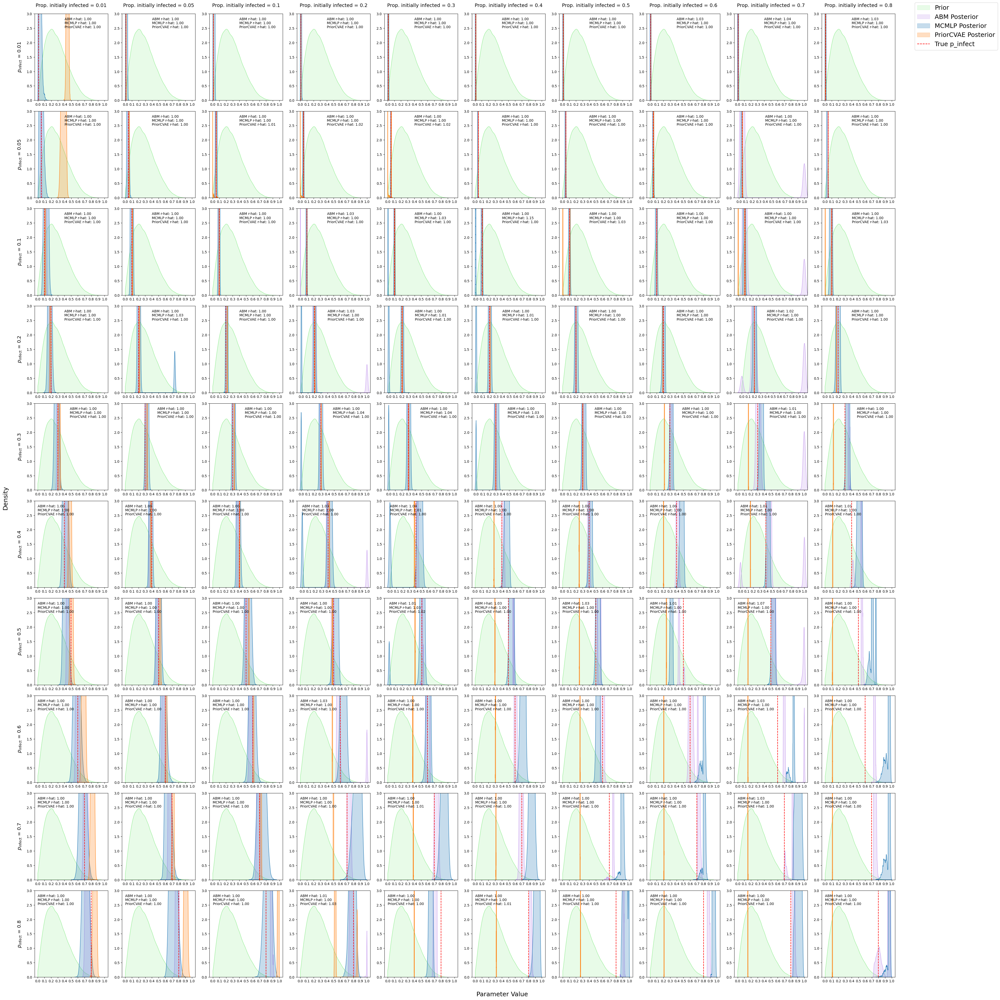

In [8]:
fig, axarr = plt.subplots(10,10,figsize=(40, 40))

for row,p_inf in enumerate([0.01, 0.05, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8]):
    for col,prop_init_infected in enumerate([0.01, 0.05, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8]):
        rhats={'abm':abm_posterior[(p_inf, prop_init_infected)]["mcmc_summary"][0]['r_hat'],
                'mcmlp':surrogates_posterior['mcmlp'][(p_inf, prop_init_infected)]["mcmc_summary"][0]['r_hat'],
                'priorcvae':surrogates_posterior['priorcvae'][(p_inf, prop_init_infected)]["mcmc_summary"][0]['r_hat']}
        axarr[row,col] = posterior_comparison(
                axarr[row,col],
                (p_inf, prop_init_infected),
                abm_posterior,
                surrogates_posterior,
                (p_inf, "p_infect"),
                rhats,
                prior_predictions,
                xlim=(None, 1.05),
                ylim=(0, 3),
                logdensities=False,
                show_legend=False,
                set_x_and_ylabels=False,
            )
        
        surrogate_r_hat_string = '\n'.join([f"{disp_name} r-hat: {rhats[surrogate_name]:.2f}" for surrogate_name,disp_name in zip(['mcmlp','priorcvae'], 
                                                                                                                                               ['MCMLP', 'PriorCVAE'])])
        if row<=3:
            text_x=0.4
        elif row==4:
            text_x=0.48
        else:
            text_x=0.00
        axarr[row,col].annotate(
            f"ABM r-hat: {rhats['abm']:.2f}\n"+surrogate_r_hat_string,
            (text_x,2.5),
            )
        axarr[row,col].set_xticks(jnp.arange(0.0, 1.1, 0.1)) 
        #axarr[row,col].set_xticks(jnp.arange(0.0,1.1,0.1),jnp.arange(0.0,1.1,0.1))


legend_handles=[]
for color in [get_color_by_label(axarr[0,0],'Prior'), 
            get_color_by_label(axarr[0,0],'ABM Posterior'),
            get_color_by_label(axarr[0,0],'mcmlp Posterior'),
            get_color_by_label(axarr[0,0],'priorcvae Posterior')]:
    legend_handle=mpatches.Patch(color=color)
    legend_handles.append(legend_handle)
legend_handles.append(Line2D([0],[0],color='red', linestyle='--'))

for idx,p_infect in enumerate([0.01, 0.05, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8]):
    axarr[idx, 0].set_ylabel(f'$p_{{\mathrm{{infect}}}}$ = {p_infect}', rotation=90, labelpad=20, va='center',fontsize=14)

for jdx, initial_infected in enumerate([0.01, 0.05, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8]):
    axarr[0,jdx].set_xlabel(f"Prop. initially infected = {initial_infected}",labelpad=20,fontsize=14)
    axarr[0, jdx].xaxis.set_label_position('top') 

fig.legend(handles=legend_handles, labels=['Prior', 'ABM Posterior', 'MCMLP Posterior', 'PriorCVAE Posterior', 'True p_infect'],
           loc='upper right', bbox_to_anchor=(1, 1), bbox_transform=fig.transFigure,fontsize=18)
fig.supylabel('Density',fontsize=18,x=-0.001)
fig.supxlabel('Parameter Value',fontsize=18,y=-0.001)
# fig.suptitle('Comparison of ABM and surrogate posteriors across 100 combinations of prob_infect and initial_infected\nGrid Size 40 and Number of Steps 10', 
#              y=1.01,fontsize=20)
plt.tight_layout(rect=[0, 0, 0.90, 1],h_pad=1,w_pad=1)
fig.savefig('../04_24_viz/g40_s10_posteriors.pdf')

plt.show()

<>:55: SyntaxWarning: invalid escape sequence '\m'
<>:55: SyntaxWarning: invalid escape sequence '\m'
/tmp/ipykernel_30356/2190677421.py:55: SyntaxWarning: invalid escape sequence '\m'
  axarr[idx, 0].set_ylabel(f'$p_{{\mathrm{{infect}}}}$ = {p_infect}', rotation=90, labelpad=20, va='center',fontsize=14)


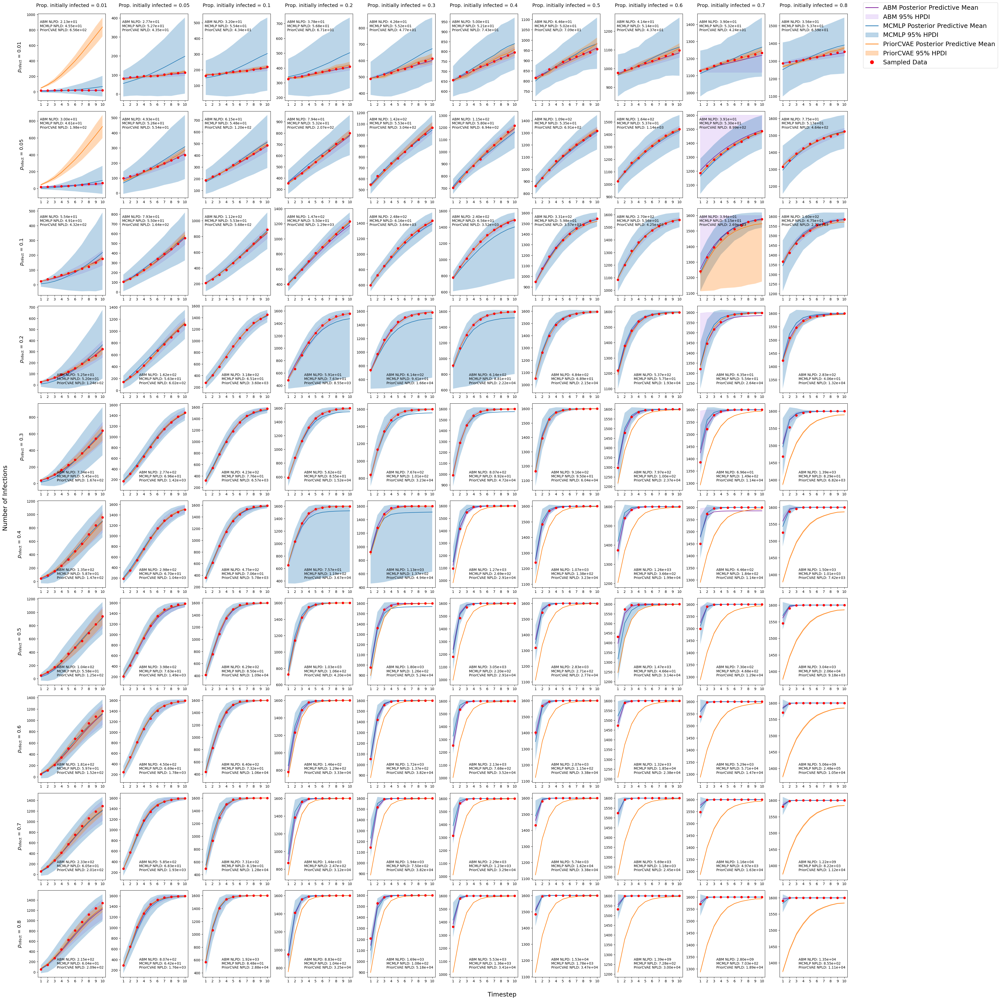

In [9]:
fig, axarr = plt.subplots(10,10,figsize=(40, 40))

nlpd_dict = {
    'abm':{k:v for k,v in zip(abm_posterior.keys(),g40_s10_metrics['NLPD']['abm'])},
    'mcmlp': {k:v for k,v in zip(abm_posterior.keys(),g40_s10_metrics['NLPD']['mcmlp'])},
    'priorcvae': {k:v for k,v in zip(abm_posterior.keys(),g40_s10_metrics['NLPD']['priorcvae'])},
}


for row,p_inf in enumerate([0.01, 0.05, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8]):
    for col,prop_init_infected in enumerate([0.01, 0.05, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8]):
        axarr[row,col] =post_prediction_comparison(
            axarr[row,col],
            (p_inf,prop_init_infected),
            abm_posterior,
            surrogates_posterior,
            data,
            None, hpdi_alpha=0.3,
            show_legend=False,
            set_x_and_ylabels=False,
        ) 
        axarr[row,col].set_xticks(jnp.arange(0,10),jnp.arange(1,11))
        surrogate_nlpd_string = '\n'.join([f"{disp_name} NPLD: {nlpd_dict[surrogate_name][(p_inf,prop_init_infected)]:.2e}" for surrogate_name,disp_name in zip(['mcmlp','priorcvae'], 
                                                                                                                                               ['MCMLP', 'PriorCVAE'])])
        if row<=2:
            text_x=0.03
            text_y=0.8
        else:
            text_x=0.28
            text_y =0.1
        axarr[row,col].annotate(
            f"ABM NLPD: {nlpd_dict['abm'][(p_inf,prop_init_infected)]:.2e}\n"+surrogate_nlpd_string,
            (text_x,text_y),
            xycoords='axes fraction'
            )
        

legend_handles=[]
for idx,color in enumerate([get_color_by_label(axarr[0,0],'ABM Posterior Predictive Mean'), 
            get_color_by_label(axarr[0,0],'ABM 95% HPDI'),
            get_color_by_label(axarr[0,0],'mcmlp Posterior Predictive Mean'),
            get_color_by_label(axarr[0,0],'mcmlp 95% HPDI'),
            get_color_by_label(axarr[0,0],'priorcvae Posterior Predictive Mean'),
            get_color_by_label(axarr[0,0],'priorcvae 95% HPDI')]):
    if idx%2==0:
        legend_handle = Line2D([0],[0],color=color,
                           linestyle='-',linewidth=2)
    else:
        legend_handle=mpatches.Patch(color=color)
    legend_handles.append(legend_handle)
legend_handles.append(Line2D([],[],color='None', marker='o',linestyle='None',markersize=10,
                             markerfacecolor='red',markeredgecolor='red'))

for idx,p_infect in enumerate([0.01, 0.05, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8]):
    axarr[idx, 0].set_ylabel(f'$p_{{\mathrm{{infect}}}}$ = {p_infect}', rotation=90, labelpad=20, va='center',fontsize=14)

for jdx, initial_infected in enumerate([0.01, 0.05, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8]):
    axarr[0,jdx].set_xlabel(f"Prop. initially infected = {initial_infected}",labelpad=20,fontsize=14)
    axarr[0, jdx].xaxis.set_label_position('top') 

fig.legend(handles=legend_handles, labels=['ABM Posterior Predictive Mean', 
                                           'ABM 95% HPDI', 
                                           'MCMLP Posterior Predictive Mean', 
                                           'MCMLP 95% HPDI',
                                           'PriorCVAE Posterior Predictive Mean', 
                                           'PriorCVAE 95% HPDI',
                                           'Sampled Data'],
           loc='upper right', bbox_to_anchor=(1, 1), bbox_transform=fig.transFigure,fontsize=18)
fig.supylabel('Number of Infections',fontsize=18,x=-0.001)
fig.supxlabel('Timestep',fontsize=18,y=-0.001)
# fig.suptitle('Comparison of ABM and surrogate posterior predictions across 100 combinations of prob_infect and initial_infected\nGrid Size 40 and Num Steps 10', 
#              y=1.01,fontsize=20)
plt.tight_layout(rect=[0, 0, 0.85, 1],h_pad=1,w_pad=1)
fig.savefig('../04_24_viz/g40_s10_preds.pdf')
plt.show()

In [10]:
del abm_posterior
del surrogates_posterior
del prior_predictions
del data
gc.collect()

0

## Grid Size 40 and Steps 20

In [ ]:
g40_s20_output_dir = "../inference_outputs/2025-04-25/02-51-57/"

with open(f"{g40_s20_output_dir}/prior_predictions.npy", "rb") as f:
    prior_predictions = jnp.load(f, allow_pickle=True).item()
with open(f"{g40_s20_output_dir}/abm_posterior.npy", "rb") as f:
    abm_posterior = jnp.load(f, allow_pickle=True).item()
with open(f"{g40_s20_output_dir}/surrogates_posterior.npy", "rb") as f:
    surrogates_posterior = jnp.load(f, allow_pickle=True).item()
with open(f"{g40_s20_output_dir}/data.npy", "rb") as f:
    data = jnp.load(f, allow_pickle=True).item()

g40_s20_abm_times = [x['mcmc_time'] for x in abm_posterior.values()]
g40_s20_mcmlp_times = [x['mcmc_time'] for x in surrogates_posterior['mcmlp'].values()]
g40_s20_priorcvae_times = [x['mcmc_time'] for x in surrogates_posterior['priorcvae'].values()]


In [ ]:
g40_s20_metrics = calculate_metrics(abm_posterior, surrogates_posterior, grid_size=40, num_steps=20, n_subsample=1000)
with open('../04_24_viz/g40_s20_metrics.pkl','wb') as f:
    pickle.dump(g40_s20_metrics,f)

In [ ]:
print(np.mean(g40_s20_abm_times), np.std(g40_s20_abm_times))
print(np.mean(g40_s20_mcmlp_times), np.std(g40_s20_mcmlp_times))
print(np.mean(g40_s20_priorcvae_times), np.std(g40_s20_priorcvae_times))

In [ ]:
abm_ess_per_sec = jnp.array([abm_posterior[abm_conf]['mcmc_summary'][0]['n_eff']/abm_posterior[abm_conf]['mcmc_time'] for abm_conf in abm_posterior.keys()])
mcmlp_ess_per_sec = jnp.array([surrogates_posterior['mcmlp'][abm_conf]['mcmc_summary'][0]['n_eff']/surrogates_posterior['mcmlp'][abm_conf]['mcmc_time'] for abm_conf in abm_posterior.keys()])
priorcvae_ess_per_sec = jnp.array([surrogates_posterior['priorcvae'][abm_conf]['mcmc_summary'][0]['n_eff']/surrogates_posterior['priorcvae'][abm_conf]['mcmc_time'] for abm_conf in abm_posterior.keys()])
print(f'ABM - ESS per sec {jnp.mean(abm_ess_per_sec):.2f} +- {jnp.std(abm_ess_per_sec):.2f}')
print(f'MCMLP - ESS per sec {jnp.mean(mcmlp_ess_per_sec):.2f} +- {jnp.std(mcmlp_ess_per_sec):.2f}')
print(f'PriorCVAE - ESS per sec {jnp.mean(priorcvae_ess_per_sec):.2f} +- {jnp.std(priorcvae_ess_per_sec):.2f}')

print(50*"=")

abm_post_means = jnp.array([jnp.mean(abm_posterior[abm_conf]['posterior_samples']['p_infect']) for abm_conf in abm_posterior.keys()])
mcmlp_post_means = jnp.array([jnp.mean(surrogates_posterior['mcmlp'][abm_conf]['posterior_samples']['p_infect']) for abm_conf in abm_posterior.keys()])
priorcvae_post_means = jnp.array([jnp.mean(surrogates_posterior['priorcvae'][abm_conf]['posterior_samples']['p_infect']) for abm_conf in abm_posterior.keys()])

print(f'MCMLP - Posterior Mean MSE {jnp.mean(jnp.square(abm_post_means-mcmlp_post_means)):.3f}')
print(f'PriorCVAE - Posterior Mean MSE {jnp.mean(jnp.square(abm_post_means-priorcvae_post_means)):.3f}')

print(50*'=')
# NOTE: Redo keys
sorted_abm_dists = jnp.array([sorted(jax.random.choice(jax.random.PRNGKey(0),
                                                       abm_posterior[abm_conf]['posterior_samples']['p_infect'],
                                                       (1000,))) for abm_conf in abm_posterior.keys()])
sorted_mcmlp_dists = jnp.array([sorted(jax.random.choice(jax.random.PRNGKey(1), 
                                                         surrogates_posterior['mcmlp'][abm_conf]['posterior_samples']['p_infect'],
                                                         (1000,))) for abm_conf in abm_posterior.keys()])
sorted_priorcvae_dists = jnp.array([sorted(jax.random.choice(jax.random.PRNGKey(2), 
                                                         surrogates_posterior['priorcvae'][abm_conf]['posterior_samples']['p_infect'],
                                                         (1000,))) for abm_conf in abm_posterior.keys()])
print(f'MCMLP - 1-Wassterstein: {1e-3*jnp.sum(jnp.abs(sorted_abm_dists-sorted_mcmlp_dists)):.2f}')
print(f'PriorCVAE - 1-Wassterstein: {1e-3*jnp.sum(jnp.abs(sorted_abm_dists-sorted_priorcvae_dists)):.2f}')

In [ ]:
for abm_conf in abm_posterior.keys():
    print(f'================{abm_conf}=======================')
    ok=True
    abm_rhat = abm_posterior[abm_conf]["mcmc_summary"][0]['r_hat']
    mcmlp_rhat = surrogates_posterior["mcmlp"][abm_conf]["mcmc_summary"][0]["r_hat"]
    priorcvae_rhat = surrogates_posterior["priorcvae"][abm_conf]["mcmc_summary"][0]["r_hat"]
    
    abm_ess = abm_posterior[abm_conf]["mcmc_summary"][0]['n_eff']
    mcmlp_ess = surrogates_posterior["mcmlp"][abm_conf]["mcmc_summary"][0]["n_eff"]
    priorcvae_ess = surrogates_posterior["priorcvae"][abm_conf]["mcmc_summary"][0]["n_eff"]

    if abm_rhat>=1.1: print(f'BAD ABM MCMC r_hat: {abm_rhat:.3f}'); ok=False
    if mcmlp_rhat>=1.1: print(f'BAD MCMLP MCMC r_hat: {mcmlp_rhat:.3f}'); ok=False
    if priorcvae_rhat>=1.1: print(f'BAD PriorCVAE MCMC r_hat: {priorcvae_rhat:.3f}');ok=False

    if abm_ess<400: print(f'BAD ABM MCMC ESS: {abm_ess:.3f}'); ok=False
    if mcmlp_ess<400: print(f'BAD MCMLP MCMC ESS: {mcmlp_ess:.3f}'); ok=False
    if priorcvae_ess<400: print(f'BAD PriorCVAE MCMC ESS: {priorcvae_ess:.3f}');ok=False
    if ok:
        print('All r_hats and ess ok')

<>:48: SyntaxWarning: invalid escape sequence '\m'
<>:48: SyntaxWarning: invalid escape sequence '\m'
/tmp/ipykernel_176399/73382739.py:48: SyntaxWarning: invalid escape sequence '\m'
  axarr[idx, 0].set_ylabel(f'$p_{{\mathrm{{infect}}}}$ = {p_infect}', rotation=90, labelpad=20, va='center',fontsize=14)


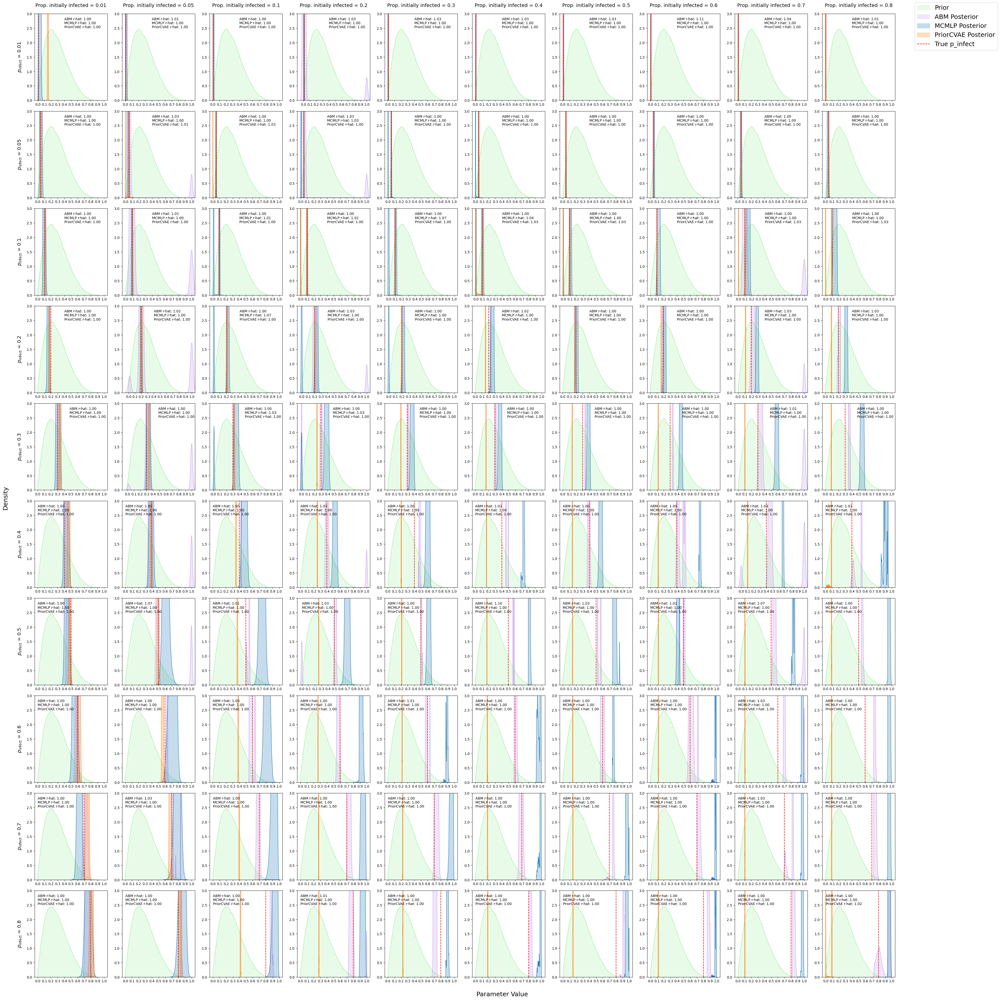

In [26]:
fig, axarr = plt.subplots(10,10,figsize=(40, 40))

for row,p_inf in enumerate([0.01, 0.05, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8]):
    for col,prop_init_infected in enumerate([0.01, 0.05, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8]):
        rhats={'abm':abm_posterior[(p_inf, prop_init_infected)]["mcmc_summary"][0]['r_hat'],
                'mcmlp':surrogates_posterior['mcmlp'][(p_inf, prop_init_infected)]["mcmc_summary"][0]['r_hat'],
                'priorcvae':surrogates_posterior['priorcvae'][(p_inf, prop_init_infected)]["mcmc_summary"][0]['r_hat']}
        axarr[row,col] = posterior_comparison(
                axarr[row,col],
                (p_inf, prop_init_infected),
                abm_posterior,
                surrogates_posterior,
                (p_inf, "p_infect"),
                rhats,
                prior_predictions,
                xlim=(None, 1.05),
                ylim=(0, 3),
                logdensities=False,
                show_legend=False,
                set_x_and_ylabels=False,
            )
        axarr[row,col].set_xticks(jnp.arange(0,1.1,0.1))
        
        surrogate_r_hat_string = '\n'.join([f"{disp_name} r-hat: {rhats[surrogate_name]:.2f}" for surrogate_name,disp_name in zip(['mcmlp','priorcvae'], 
                                                                                                                                               ['MCMLP', 'PriorCVAE'])])
        if row<=3:
            text_x=0.4
        elif row==4:
            text_x=0.48
        else:
            text_x=0.00
        axarr[row,col].annotate(
            f"ABM r-hat: {rhats['abm']:.2f}\n"+surrogate_r_hat_string,
            (text_x,2.5),
            )


legend_handles=[]
for color in [get_color_by_label(axarr[0,0],'Prior'), 
            get_color_by_label(axarr[0,0],'ABM Posterior'),
            get_color_by_label(axarr[0,0],'mcmlp Posterior'),
            get_color_by_label(axarr[0,0],'priorcvae Posterior')]:
    legend_handle=mpatches.Patch(color=color)
    legend_handles.append(legend_handle)
legend_handles.append(Line2D([0],[0],color='red', linestyle='--'))

for idx,p_infect in enumerate([0.01, 0.05, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8]):
    axarr[idx, 0].set_ylabel(f'$p_{{\mathrm{{infect}}}}$ = {p_infect}', rotation=90, labelpad=20, va='center',fontsize=14)

for jdx, initial_infected in enumerate([0.01, 0.05, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8]):
    axarr[0,jdx].set_xlabel(f"Prop. initially infected = {initial_infected}",labelpad=20,fontsize=14)
    axarr[0, jdx].xaxis.set_label_position('top') 


fig.legend(handles=legend_handles, labels=['Prior', 'ABM Posterior', 'MCMLP Posterior', 'PriorCVAE Posterior', 'True p_infect'],
           loc='upper right', bbox_to_anchor=(1, 1), bbox_transform=fig.transFigure,fontsize=18)
fig.supylabel('Density',fontsize=18,x=-0.001)
fig.supxlabel('Parameter Value',fontsize=18,y=-0.001)
# fig.suptitle('Comparison of ABM and surrogate posteriors across 100 combinations of prob_infect and initial_infected\nGrid Size 40 and Number of Steps 20', 
#              y=1.01,fontsize=20)
plt.tight_layout(rect=[0, 0, 0.90, 1],h_pad=1,w_pad=1)
fig.savefig("../04_24_viz/g40_s20_posteriors.pdf")

plt.show()

In [23]:
with open('../04_24_viz/g40_s20_metrics.pkl','rb') as f:
    g40_s20_metrics = pickle.load(f)

<>:52: SyntaxWarning: invalid escape sequence '\m'
<>:52: SyntaxWarning: invalid escape sequence '\m'
/tmp/ipykernel_176399/3402378354.py:52: SyntaxWarning: invalid escape sequence '\m'
  axarr[idx, 0].set_ylabel(f'$p_{{\mathrm{{infect}}}}$ = {p_infect}', rotation=90, labelpad=20, va='center',fontsize=14)


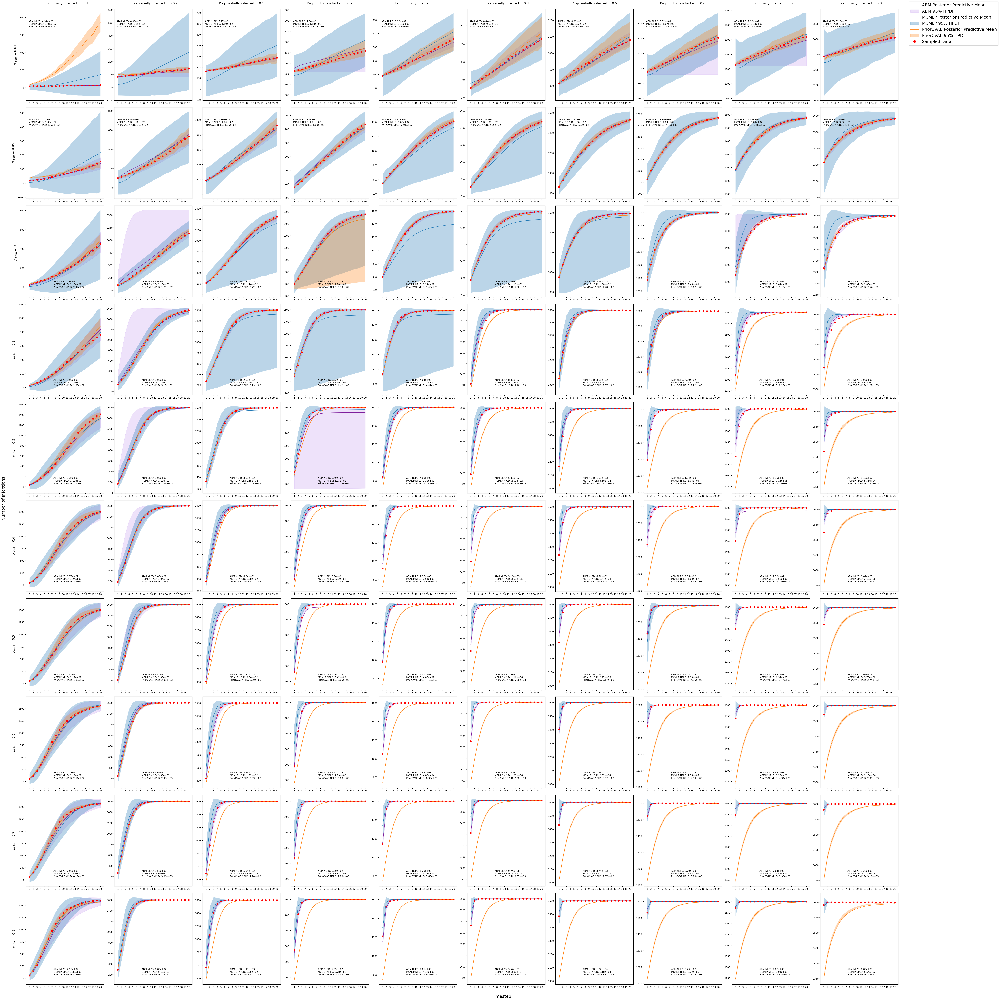

In [27]:
fig, axarr = plt.subplots(10,10,figsize=(60, 60))
nlpd_dict = {
    'abm':{k:v for k,v in zip(abm_posterior.keys(),g40_s20_metrics['NLPD']['abm'])},
    'mcmlp': {k:v for k,v in zip(abm_posterior.keys(),g40_s20_metrics['NLPD']['mcmlp'])},
    'priorcvae': {k:v for k,v in zip(abm_posterior.keys(),g40_s20_metrics['NLPD']['priorcvae'])},
}
for row,p_inf in enumerate([0.01, 0.05, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8]):
    for col,prop_init_infected in enumerate([0.01, 0.05, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8]):
        axarr[row,col] =post_prediction_comparison(
            axarr[row,col],
            (p_inf,prop_init_infected),
            abm_posterior,
            surrogates_posterior,
            data,
            None, hpdi_alpha=0.3,
            show_legend=False,
            set_x_and_ylabels=False,
        ) 
        axarr[row,col].set_xticks(jnp.arange(0,20),jnp.arange(1,21))
        surrogate_nlpd_string = '\n'.join([f"{disp_name} NPLD: {nlpd_dict[surrogate_name][(p_inf,prop_init_infected)]:.2e}" for surrogate_name,disp_name in zip(['mcmlp','priorcvae'], 
                                                                                                                                               ['MCMLP', 'PriorCVAE'])])
        if row<=1:
            text_x=0.03
            text_y=0.8
        else:
            text_x=0.35
            text_y =0.1
        axarr[row,col].annotate(
            f"ABM NLPD: {nlpd_dict['abm'][(p_inf,prop_init_infected)]:.2e}\n"+surrogate_nlpd_string,
            (text_x,text_y),
            xycoords='axes fraction'
            )


legend_handles=[]
for idx,color in enumerate([get_color_by_label(axarr[0,0],'ABM Posterior Predictive Mean'), 
            get_color_by_label(axarr[0,0],'ABM 95% HPDI'),
            get_color_by_label(axarr[0,0],'mcmlp Posterior Predictive Mean'),
            get_color_by_label(axarr[0,0],'mcmlp 95% HPDI'),
            get_color_by_label(axarr[0,0],'priorcvae Posterior Predictive Mean'),
            get_color_by_label(axarr[0,0],'priorcvae 95% HPDI')]):
    if idx%2==0:
        legend_handle = Line2D([0],[0],color=color,
                           linestyle='-',linewidth=2)
    else:
        legend_handle=mpatches.Patch(color=color)
    legend_handles.append(legend_handle)
legend_handles.append(Line2D([],[],color='None', marker='o',linestyle='None',markersize=10,
                             markerfacecolor='red',markeredgecolor='red'))

for idx,p_infect in enumerate([0.01, 0.05, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8]):
    axarr[idx, 0].set_ylabel(f'$p_{{\mathrm{{infect}}}}$ = {p_infect}', rotation=90, labelpad=20, va='center',fontsize=14)

for jdx, initial_infected in enumerate([0.01, 0.05, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8]):
    axarr[0,jdx].set_xlabel(f"Prop. initially infected = {initial_infected}",labelpad=20,fontsize=14)
    axarr[0, jdx].xaxis.set_label_position('top') 

fig.legend(handles=legend_handles, labels=['ABM Posterior Predictive Mean', 
                                           'ABM 95% HPDI', 
                                           'MCMLP Posterior Predictive Mean', 
                                           'MCMLP 95% HPDI',
                                           'PriorCVAE Posterior Predictive Mean', 
                                           'PriorCVAE 95% HPDI',
                                           'Sampled Data'],
           loc='upper right', bbox_to_anchor=(1, 1), bbox_transform=fig.transFigure,fontsize=18)
fig.supylabel('Number of Infections',fontsize=18,x=-0.001)
fig.supxlabel('Timestep',fontsize=18,y=-0.001)
# fig.suptitle('Comparison of ABM and surrogate posterior predictions across 100 combinations of prob_infect and initial_infected\nGrid Size 40 and Num Steps 20', 
#              y=1.01,fontsize=20)
plt.tight_layout(rect=[0, 0, 0.90, 1],h_pad=1,w_pad=1)
fig.savefig('../04_24_viz/g40_s20_preds.pdf')
plt.show()

In [12]:
del abm_posterior
del surrogates_posterior
del prior_predictions
del data
gc.collect()

0

## Grid Size 160 and Steps 10

In [ ]:
g160_s10_output_dir = "inference_outputs/2025-04-25/10-25-25/"

with open(f"{g160_s10_output_dir}/prior_predictions.npy", "rb") as f:
    prior_predictions = jnp.load(f, allow_pickle=True).item()
with open(f"{g160_s10_output_dir}/abm_posterior.npy", "rb") as f:
    abm_posterior = jnp.load(f, allow_pickle=True).item()
with open(f"{g160_s10_output_dir}/surrogates_posterior.npy", "rb") as f:
    surrogates_posterior = jnp.load(f, allow_pickle=True).item()
with open(f"{g160_s10_output_dir}/data.npy", "rb") as f:
    data = jnp.load(f, allow_pickle=True).item()

g160_s10_abm_times = [x['mcmc_time'] for x in abm_posterior.values()]
g160_s10_mcmlp_times = [x['mcmc_time'] for x in surrogates_posterior['mcmlp'].values()]
g160_s10_priorcvae_times = [x['mcmc_time'] for x in surrogates_posterior['priorcvae'].values()]


In [ ]:
g160_s10_metrics = calculate_metrics(abm_posterior, surrogates_posterior, 
                                     grid_size=160, num_steps=10, n_subsample=1000)
with open('../04_24_viz/g160_s10_metrics.pkl','wb') as f:
    pickle.dump(g160_s10_metrics,f)

In [ ]:

abm_ess_per_sec = jnp.array([abm_posterior[abm_conf]['mcmc_summary'][0]['n_eff']/abm_posterior[abm_conf]['mcmc_time'] for abm_conf in abm_posterior.keys()])
mcmlp_ess_per_sec = jnp.array([surrogates_posterior['mcmlp'][abm_conf]['mcmc_summary'][0]['n_eff']/surrogates_posterior['mcmlp'][abm_conf]['mcmc_time'] for abm_conf in abm_posterior.keys()])
priorcvae_ess_per_sec = jnp.array([surrogates_posterior['priorcvae'][abm_conf]['mcmc_summary'][0]['n_eff']/surrogates_posterior['priorcvae'][abm_conf]['mcmc_time'] for abm_conf in abm_posterior.keys()])
print(f'ABM - ESS per sec {jnp.mean(abm_ess_per_sec):.2f} +- {jnp.std(abm_ess_per_sec):.2f}')
print(f'MCMLP - ESS per sec {jnp.mean(mcmlp_ess_per_sec):.2f} +- {jnp.std(mcmlp_ess_per_sec):.2f}')
print(f'PriorCVAE - ESS per sec {jnp.mean(priorcvae_ess_per_sec):.2f} +- {jnp.std(priorcvae_ess_per_sec):.2f}')

print(50*"=")

abm_post_means = jnp.array([jnp.mean(abm_posterior[abm_conf]['posterior_samples']['p_infect']) for abm_conf in abm_posterior.keys()])
mcmlp_post_means = jnp.array([jnp.mean(surrogates_posterior['mcmlp'][abm_conf]['posterior_samples']['p_infect']) for abm_conf in abm_posterior.keys()])
priorcvae_post_means = jnp.array([jnp.mean(surrogates_posterior['priorcvae'][abm_conf]['posterior_samples']['p_infect']) for abm_conf in abm_posterior.keys()])

print(f'MCMLP - Posterior Mean MSE {jnp.mean(jnp.square(abm_post_means-mcmlp_post_means)):.2f}')
print(f'PriorCVAE - Posterior Mean MSE {jnp.mean(jnp.square(abm_post_means-priorcvae_post_means)):.3f}')

print(50*'=')
# NOTE: Redo keys
sorted_abm_dists = jnp.array([sorted(jax.random.choice(jax.random.PRNGKey(0),
                                                       abm_posterior[abm_conf]['posterior_samples']['p_infect'],
                                                       (1000,))) for abm_conf in abm_posterior.keys()])
sorted_mcmlp_dists = jnp.array([sorted(jax.random.choice(jax.random.PRNGKey(1), 
                                                         surrogates_posterior['mcmlp'][abm_conf]['posterior_samples']['p_infect'],
                                                         (1000,))) for abm_conf in abm_posterior.keys()])
sorted_priorcvae_dists = jnp.array([sorted(jax.random.choice(jax.random.PRNGKey(2), 
                                                         surrogates_posterior['priorcvae'][abm_conf]['posterior_samples']['p_infect'],
                                                         (1000,))) for abm_conf in abm_posterior.keys()])
print(f'MCMLP - 1-Wassterstein: {1e-3*jnp.sum(jnp.abs(sorted_abm_dists-sorted_mcmlp_dists)):.2f}')
print(f'PriorCVAE - 1-Wassterstein: {1e-3*jnp.sum(jnp.abs(sorted_abm_dists-sorted_priorcvae_dists)):.2f}')

In [31]:
for abm_conf in abm_posterior.keys():
    print(f'================{abm_conf}=======================')
    ok=True
    abm_rhat = abm_posterior[abm_conf]["mcmc_summary"][0]['r_hat']
    mcmlp_rhat = surrogates_posterior["mcmlp"][abm_conf]["mcmc_summary"][0]["r_hat"]
    priorcvae_rhat = surrogates_posterior["priorcvae"][abm_conf]["mcmc_summary"][0]["r_hat"]
    
    abm_ess = abm_posterior[abm_conf]["mcmc_summary"][0]['n_eff']
    mcmlp_ess = surrogates_posterior["mcmlp"][abm_conf]["mcmc_summary"][0]["n_eff"]
    priorcvae_ess = surrogates_posterior["priorcvae"][abm_conf]["mcmc_summary"][0]["n_eff"]

    if abm_rhat>=1.1: print(f'BAD ABM MCMC r_hat: {abm_rhat:.3f}'); ok=False
    if mcmlp_rhat>=1.1: print(f'BAD MCMLP MCMC r_hat: {mcmlp_rhat:.3f}'); ok=False
    if priorcvae_rhat>=1.1: print(f'BAD PriorCVAE MCMC r_hat: {priorcvae_rhat:.3f}');ok=False

    if abm_ess<400: print(f'BAD ABM MCMC ESS: {abm_ess:.3f}'); ok=False
    if mcmlp_ess<400: print(f'BAD MCMLP MCMC ESS: {mcmlp_ess:.3f}'); ok=False
    if priorcvae_ess<400: print(f'BAD PriorCVAE MCMC ESS: {priorcvae_ess:.3f}');ok=False
    if ok:
        print('All r_hats and ess ok')

================(0.01, 0.01)=======================
All r_hats and ess ok
================(0.01, 0.5)=======================
BAD ABM MCMC ESS: 33.188
================(0.01, 0.8)=======================
All r_hats and ess ok
================(0.5, 0.01)=======================
All r_hats and ess ok
================(0.5, 0.5)=======================
BAD ABM MCMC ESS: 34.219
BAD PriorCVAE MCMC ESS: 114.021
================(0.5, 0.8)=======================
All r_hats and ess ok
================(0.8, 0.01)=======================
All r_hats and ess ok
================(0.8, 0.5)=======================
BAD PriorCVAE MCMC ESS: 76.153
================(0.8, 0.8)=======================
All r_hats and ess ok


<>:47: SyntaxWarning: invalid escape sequence '\m'
<>:47: SyntaxWarning: invalid escape sequence '\m'
/tmp/ipykernel_176399/695361626.py:47: SyntaxWarning: invalid escape sequence '\m'
  axarr[idx, 0].set_ylabel(f'$p_{{\mathrm{{infect}}}}$ = {p_infect}', rotation=90, labelpad=20, va='center',fontsize=14)


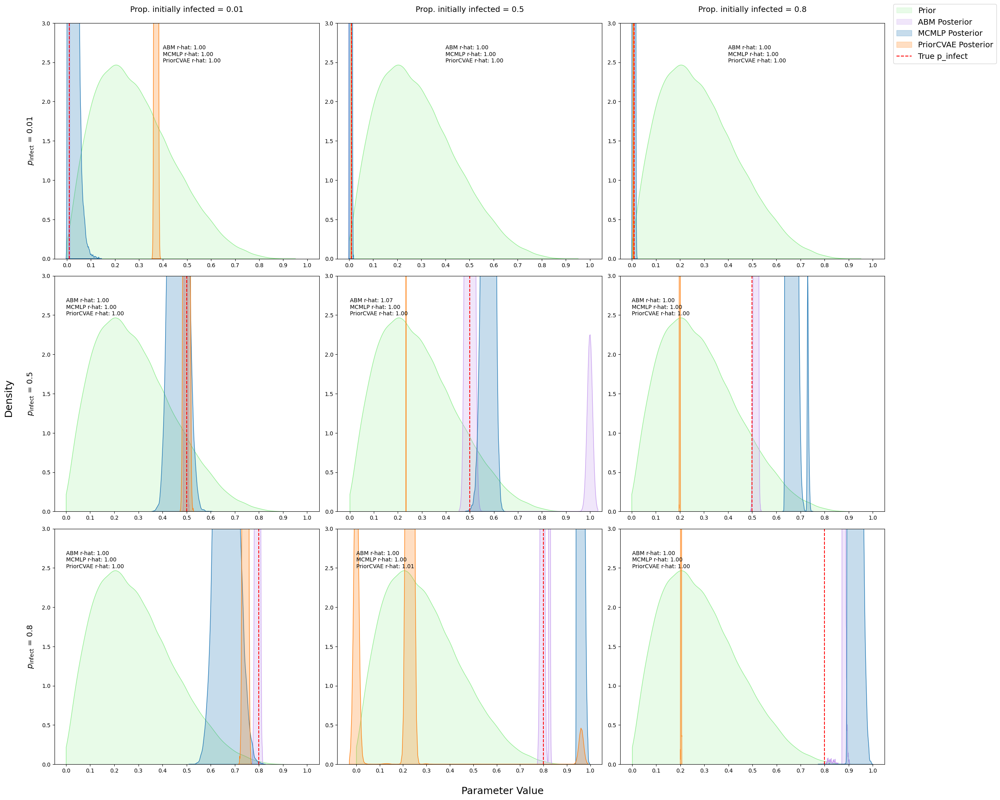

In [51]:
fig, axarr = plt.subplots(3,3,figsize=(25, 20))

for row,p_inf in enumerate([0.01, 0.5, 0.8]):
    for col,prop_init_infected in enumerate([0.01, 0.5, 0.8]):
        rhats={'abm':abm_posterior[(p_inf, prop_init_infected)]["mcmc_summary"][0]['r_hat'],
                'mcmlp':surrogates_posterior['mcmlp'][(p_inf, prop_init_infected)]["mcmc_summary"][0]['r_hat'],
                'priorcvae':surrogates_posterior['priorcvae'][(p_inf, prop_init_infected)]["mcmc_summary"][0]['r_hat']}
        axarr[row,col] = posterior_comparison(
                axarr[row,col],
                (p_inf, prop_init_infected),
                abm_posterior,
                surrogates_posterior,
                (p_inf, "p_infect"),
                rhats,
                prior_predictions,
                xlim=(None, 1.05),
                ylim=(0, 3),
                logdensities=False,
                show_legend=False,
                set_x_and_ylabels=False,
            )
        axarr[row,col].set_xticks(jnp.arange(0,1.1,0.1))
        
        surrogate_r_hat_string = '\n'.join([f"{disp_name} r-hat: {rhats[surrogate_name]:.2f}" for surrogate_name,disp_name in zip(['mcmlp','priorcvae'], 
                                                                                                                                               ['MCMLP', 'PriorCVAE'])])
        if row==0:
            text_x=0.4
        elif row==2:
            text_x==0.3
        else:
            text_x=0.0
        axarr[row,col].annotate(
            f"ABM r-hat: {rhats['abm']:.2f}\n"+surrogate_r_hat_string,
            (text_x,2.5),
            )

legend_handles=[]
for color in [get_color_by_label(axarr[0,0],'Prior'), 
            get_color_by_label(axarr[0,0],'ABM Posterior'),
            get_color_by_label(axarr[0,0],'mcmlp Posterior'),
            get_color_by_label(axarr[0,0],'priorcvae Posterior')]:
    legend_handle=mpatches.Patch(color=color)
    legend_handles.append(legend_handle)
legend_handles.append(Line2D([0],[0],color='red', linestyle='--'))

for idx,p_infect in enumerate([0.01, 0.5, 0.8]):
    axarr[idx, 0].set_ylabel(f'$p_{{\mathrm{{infect}}}}$ = {p_infect}', rotation=90, labelpad=20, va='center',fontsize=14)


for jdx, initial_infected in enumerate([0.01, 0.5, 0.8]):
    axarr[0,jdx].set_xlabel(f"Prop. initially infected = {initial_infected}",labelpad=20,fontsize=14)
    axarr[0, jdx].xaxis.set_label_position('top') 


fig.legend(handles=legend_handles, labels=['Prior', 'ABM Posterior', 'MCMLP Posterior', 'PriorCVAE Posterior', 'True p_infect'],
           loc='upper right', bbox_to_anchor=(1, 1), bbox_transform=fig.transFigure,fontsize=14)
fig.supylabel('Density',fontsize=18,x=-0.001)
fig.supxlabel('Parameter Value',fontsize=18,y=-0.001)
# fig.suptitle('Comparison of ABM and surrogate posteriors across 100 combinations of prob_infect and initial_infected\nGrid Size 160 and Number of Steps 10', 
#              y=1.01,fontsize=20)
fig.savefig('../04_24_viz/g160_s10_posteriors.pdf')
plt.tight_layout(rect=[0, 0, 0.89, 1],h_pad=1,w_pad=1)

plt.show()

In [37]:
with open('../04_24_viz/g160_s10_metrics.pkl','rb') as f:
    g160_s10_metrics = pickle.load(f)

<>:51: SyntaxWarning: invalid escape sequence '\m'
<>:51: SyntaxWarning: invalid escape sequence '\m'
/tmp/ipykernel_176399/878070314.py:51: SyntaxWarning: invalid escape sequence '\m'
  axarr[idx, 0].set_ylabel(f'$p_{{\mathrm{{infect}}}}$ = {p_infect}', rotation=90, labelpad=20, va='center',fontsize=14)


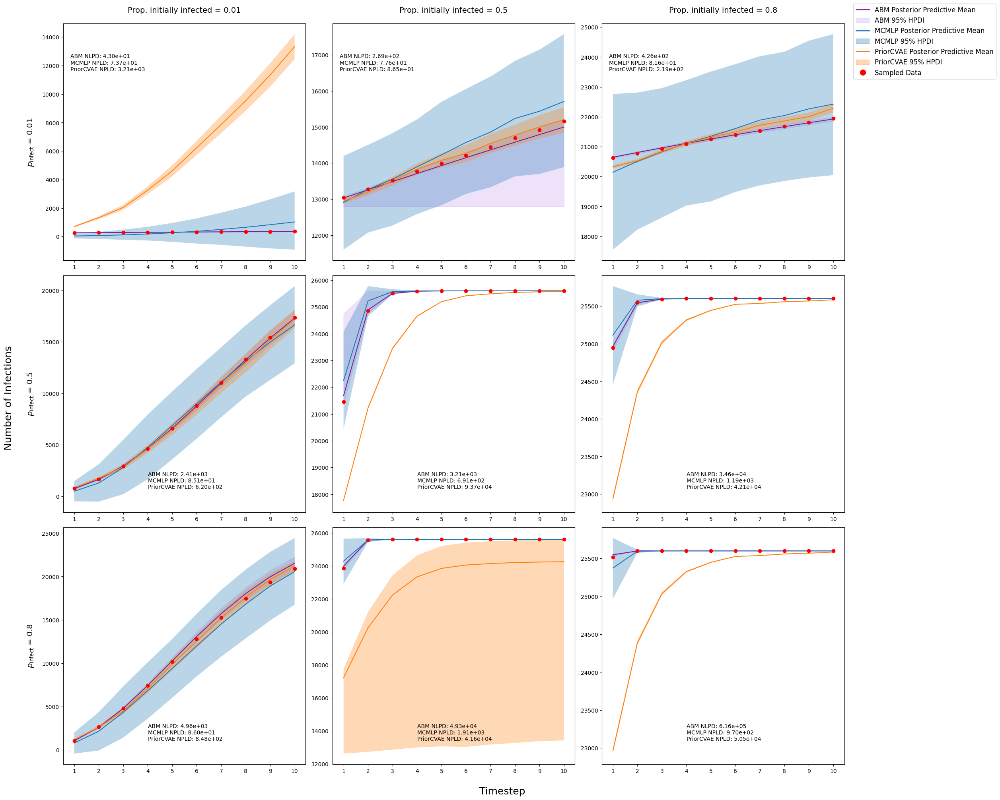

In [52]:
fig, axarr = plt.subplots(3,3,figsize=(25, 20))
nlpd_dict = {
    'abm':{k:v for k,v in zip(abm_posterior.keys(),g160_s10_metrics['NLPD']['abm'])},
    'mcmlp': {k:v for k,v in zip(abm_posterior.keys(),g160_s10_metrics['NLPD']['mcmlp'])},
    'priorcvae': {k:v for k,v in zip(abm_posterior.keys(),g160_s10_metrics['NLPD']['priorcvae'])},
}
for row,p_inf in enumerate([0.01, 0.5, 0.8]):
    for col,prop_init_infected in enumerate([0.01, 0.5, 0.8]):
        axarr[row,col] =post_prediction_comparison(
            axarr[row,col],
            (p_inf,prop_init_infected),
            abm_posterior,
            surrogates_posterior,
            data,
            None, hpdi_alpha=0.3,
            show_legend=False,
            set_x_and_ylabels=False,
        )
        axarr[row,col].set_xticks(jnp.arange(0,10),jnp.arange(1,11))
        surrogate_nlpd_string = '\n'.join([f"{disp_name} NPLD: {nlpd_dict[surrogate_name][(p_inf,prop_init_infected)]:.2e}" for surrogate_name,disp_name in zip(['mcmlp','priorcvae'], 
                                                                                                                                               ['MCMLP', 'PriorCVAE'])])
        if row==0:
            text_x=0.03
            text_y=0.8
        else:
            text_x=0.35
            text_y =0.1
        axarr[row,col].annotate(
            f"ABM NLPD: {nlpd_dict['abm'][(p_inf,prop_init_infected)]:.2e}\n"+surrogate_nlpd_string,
            (text_x,text_y),
            xycoords='axes fraction'
            ) 

legend_handles=[]
for idx,color in enumerate([get_color_by_label(axarr[0,0],'ABM Posterior Predictive Mean'), 
            get_color_by_label(axarr[0,0],'ABM 95% HPDI'),
            get_color_by_label(axarr[0,0],'mcmlp Posterior Predictive Mean'),
            get_color_by_label(axarr[0,0],'mcmlp 95% HPDI'),
            get_color_by_label(axarr[0,0],'priorcvae Posterior Predictive Mean'),
            get_color_by_label(axarr[0,0],'priorcvae 95% HPDI')]):
    if idx%2==0:
        legend_handle = Line2D([0],[0],color=color,
                           linestyle='-',linewidth=2)
    else:
        legend_handle=mpatches.Patch(color=color)
    legend_handles.append(legend_handle)
legend_handles.append(Line2D([],[],color='None', marker='o',linestyle='None',markersize=10,
                             markerfacecolor='red',markeredgecolor='red'))

for idx,p_infect in enumerate([0.01, 0.5, 0.8]):
    axarr[idx, 0].set_ylabel(f'$p_{{\mathrm{{infect}}}}$ = {p_infect}', rotation=90, labelpad=20, va='center',fontsize=14)


for jdx, initial_infected in enumerate([0.01, 0.5, 0.8]):
    axarr[0,jdx].set_xlabel(f"Prop. initially infected = {initial_infected}",labelpad=20,fontsize=14)
    axarr[0, jdx].xaxis.set_label_position('top') 


fig.legend(handles=legend_handles, labels=['ABM Posterior Predictive Mean', 
                                           'ABM 95% HPDI', 
                                           'MCMLP Posterior Predictive Mean', 
                                           'MCMLP 95% HPDI',
                                           'PriorCVAE Posterior Predictive Mean', 
                                           'PriorCVAE 95% HPDI',
                                           'Sampled Data'],
           loc='upper right', bbox_to_anchor=(1, 1), bbox_transform=fig.transFigure,fontsize=12)
fig.supylabel('Number of Infections',fontsize=18,x=-0.001)
fig.supxlabel('Timestep',fontsize=18,y=-0.001)
# fig.suptitle('Comparison of ABM and surrogate posterior predictions across 100 combinations of prob_infect and initial_infected\nGrid Size 160 and Num Steps 10', 
#              y=1.01,fontsize=20)
plt.tight_layout(rect=[0, 0, 0.85, 1],h_pad=1,w_pad=1)
fig.savefig('../04_24_viz/g160_s10_preds.pdf')
plt.show()

In [14]:
del abm_posterior
del surrogates_posterior
del prior_predictions
del data
gc.collect()

11

## Grid Size 160 and Steps 20

In [ ]:
g160_s20_output_dir = "../inference_outputs/2025-04-25/14-31-48/"

with open(f"{g160_s20_output_dir}/prior_predictions.npy", "rb") as f:
    prior_predictions = jnp.load(f, allow_pickle=True).item()
with open(f"{g160_s20_output_dir}/abm_posterior.npy", "rb") as f:
    abm_posterior = jnp.load(f, allow_pickle=True).item()
with open(f"{g160_s20_output_dir}/surrogates_posterior.npy", "rb") as f:
    surrogates_posterior = jnp.load(f, allow_pickle=True).item()
with open(f"{g160_s20_output_dir}/data.npy", "rb") as f:
    data = jnp.load(f, allow_pickle=True).item()

g160_s20_abm_times = [x['mcmc_time'] for x in abm_posterior.values()]
g160_s20_mcmlp_times = [x['mcmc_time'] for x in surrogates_posterior['mcmlp'].values()]
g160_s20_priorcvae_times = [x['mcmc_time'] for x in surrogates_posterior['priorcvae'].values()]


In [ ]:
g160_s20_metrics = calculate_metrics(abm_posterior, surrogates_posterior, 
                                     grid_size=160, num_steps=20, n_subsample=1000)
with open('../04_24_viz/g160_s20_metrics.pkl','wb') as f:
    pickle.dump(g160_s20_metrics,f)

In [ ]:

abm_ess_per_sec = jnp.array([abm_posterior[abm_conf]['mcmc_summary'][0]['n_eff']/abm_posterior[abm_conf]['mcmc_time'] for abm_conf in abm_posterior.keys()])
mcmlp_ess_per_sec = jnp.array([surrogates_posterior['mcmlp'][abm_conf]['mcmc_summary'][0]['n_eff']/surrogates_posterior['mcmlp'][abm_conf]['mcmc_time'] for abm_conf in abm_posterior.keys()])
priorcvae_ess_per_sec = jnp.array([surrogates_posterior['priorcvae'][abm_conf]['mcmc_summary'][0]['n_eff']/surrogates_posterior['priorcvae'][abm_conf]['mcmc_time'] for abm_conf in abm_posterior.keys()])
print(f'ABM - ESS per sec {jnp.mean(abm_ess_per_sec):.2f} +- {jnp.std(abm_ess_per_sec):.2f}')
print(f'MCMLP - ESS per sec {jnp.mean(mcmlp_ess_per_sec):.2f} +- {jnp.std(mcmlp_ess_per_sec):.2f}')
print(f'PriorCVAE - ESS per sec {jnp.mean(priorcvae_ess_per_sec):.2f} +- {jnp.std(priorcvae_ess_per_sec):.2f}')

print(50*"=")

abm_post_means = jnp.array([jnp.mean(abm_posterior[abm_conf]['posterior_samples']['p_infect']) for abm_conf in abm_posterior.keys()])
mcmlp_post_means = jnp.array([jnp.mean(surrogates_posterior['mcmlp'][abm_conf]['posterior_samples']['p_infect']) for abm_conf in abm_posterior.keys()])
priorcvae_post_means = jnp.array([jnp.mean(surrogates_posterior['priorcvae'][abm_conf]['posterior_samples']['p_infect']) for abm_conf in abm_posterior.keys()])

print(f'MCMLP - Posterior Mean MSE {jnp.mean(jnp.square(abm_post_means-mcmlp_post_means)):.2f}')
print(f'PriorCVAE - Posterior Mean MSE {jnp.mean(jnp.square(abm_post_means-priorcvae_post_means)):.3f}')

print(50*'=')
# NOTE: Redo keys
sorted_abm_dists = jnp.array([sorted(jax.random.choice(jax.random.PRNGKey(0),
                                                       abm_posterior[abm_conf]['posterior_samples']['p_infect'],
                                                       (1000,))) for abm_conf in abm_posterior.keys()])
sorted_mcmlp_dists = jnp.array([sorted(jax.random.choice(jax.random.PRNGKey(1), 
                                                         surrogates_posterior['mcmlp'][abm_conf]['posterior_samples']['p_infect'],
                                                         (1000,))) for abm_conf in abm_posterior.keys()])
sorted_priorcvae_dists = jnp.array([sorted(jax.random.choice(jax.random.PRNGKey(2), 
                                                         surrogates_posterior['priorcvae'][abm_conf]['posterior_samples']['p_infect'],
                                                         (1000,))) for abm_conf in abm_posterior.keys()])
print(f'MCMLP - 1-Wassterstein: {1e-3*jnp.sum(jnp.abs(sorted_abm_dists-sorted_mcmlp_dists)):.2f}')
print(f'PriorCVAE - 1-Wassterstein: {1e-3*jnp.sum(jnp.abs(sorted_abm_dists-sorted_priorcvae_dists)):.2f}')

In [55]:
for abm_conf in abm_posterior.keys():
    print(f'================{abm_conf}=======================')
    ok=True
    abm_rhat = abm_posterior[abm_conf]["mcmc_summary"][0]['r_hat']
    mcmlp_rhat = surrogates_posterior["mcmlp"][abm_conf]["mcmc_summary"][0]["r_hat"]
    priorcvae_rhat = surrogates_posterior["priorcvae"][abm_conf]["mcmc_summary"][0]["r_hat"]
    
    abm_ess = abm_posterior[abm_conf]["mcmc_summary"][0]['n_eff']
    mcmlp_ess = surrogates_posterior["mcmlp"][abm_conf]["mcmc_summary"][0]["n_eff"]
    priorcvae_ess = surrogates_posterior["priorcvae"][abm_conf]["mcmc_summary"][0]["n_eff"]

    if abm_rhat>=1.1: print(f'BAD ABM MCMC r_hat: {abm_rhat:.3f}'); ok=False
    if mcmlp_rhat>=1.1: print(f'BAD MCMLP MCMC r_hat: {mcmlp_rhat:.3f}'); ok=False
    if priorcvae_rhat>=1.1: print(f'BAD PriorCVAE MCMC r_hat: {priorcvae_rhat:.3f}');ok=False

    if abm_ess<400: print(f'BAD ABM MCMC ESS: {abm_ess:.3f}'); ok=False
    if mcmlp_ess<400: print(f'BAD MCMLP MCMC ESS: {mcmlp_ess:.3f}'); ok=False
    if priorcvae_ess<400: print(f'BAD PriorCVAE MCMC ESS: {priorcvae_ess:.3f}');ok=False
    if ok:
        print('All r_hats and ess ok')

================(0.01, 0.01)=======================
All r_hats and ess ok
================(0.01, 0.5)=======================
BAD ABM MCMC ESS: 33.152
================(0.01, 0.8)=======================
All r_hats and ess ok
================(0.5, 0.01)=======================
All r_hats and ess ok
================(0.5, 0.5)=======================
BAD ABM MCMC ESS: 34.214
================(0.5, 0.8)=======================
All r_hats and ess ok
================(0.8, 0.01)=======================
All r_hats and ess ok
================(0.8, 0.5)=======================
All r_hats and ess ok
================(0.8, 0.8)=======================
All r_hats and ess ok


<>:47: SyntaxWarning: invalid escape sequence '\m'
<>:47: SyntaxWarning: invalid escape sequence '\m'
/tmp/ipykernel_176399/293244973.py:47: SyntaxWarning: invalid escape sequence '\m'
  axarr[idx, 0].set_ylabel(f'$p_{{\mathrm{{infect}}}}$ = {p_infect}', rotation=90, labelpad=20, va='center',fontsize=14)


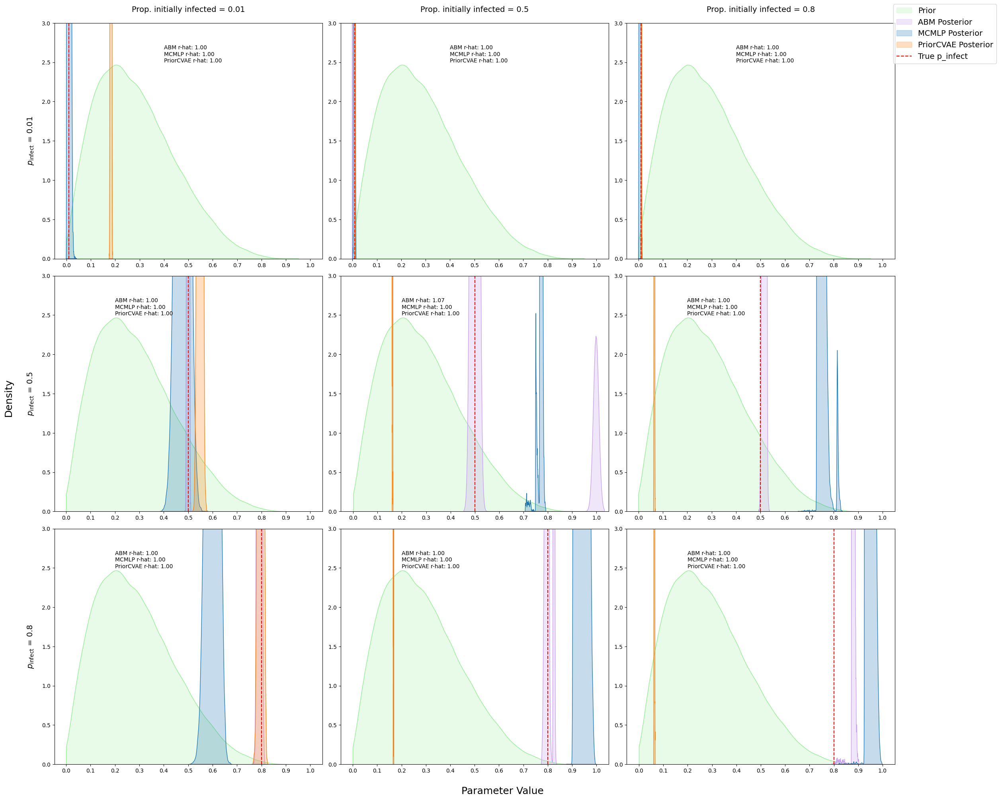

In [56]:
fig, axarr = plt.subplots(3,3,figsize=(25, 20))

for row,p_inf in enumerate([0.01, 0.5, 0.8]):
    for col,prop_init_infected in enumerate([0.01, 0.5, 0.8]):
        rhats={'abm':abm_posterior[(p_inf, prop_init_infected)]["mcmc_summary"][0]['r_hat'],
                'mcmlp':surrogates_posterior['mcmlp'][(p_inf, prop_init_infected)]["mcmc_summary"][0]['r_hat'],
                'priorcvae':surrogates_posterior['priorcvae'][(p_inf, prop_init_infected)]["mcmc_summary"][0]['r_hat']}
        axarr[row,col] = posterior_comparison(
                axarr[row,col],
                (p_inf, prop_init_infected),
                abm_posterior,
                surrogates_posterior,
                (p_inf, "p_infect"),
                rhats,
                prior_predictions,
                xlim=(None, 1.05),
                ylim=(0, 3),
                logdensities=False,
                show_legend=False,
                set_x_and_ylabels=False,
            )
        axarr[row,col].set_xticks(jnp.arange(0,1.1,0.1))
        
        surrogate_r_hat_string = '\n'.join([f"{disp_name} r-hat: {rhats[surrogate_name]:.2f}" for surrogate_name,disp_name in zip(['mcmlp','priorcvae'], 
                                                                                                                                               ['MCMLP', 'PriorCVAE'])])
        if row==0:
            text_x=0.4
        else:
            text_x=0.2
        axarr[row,col].annotate(
            f"ABM r-hat: {rhats['abm']:.2f}\n"+surrogate_r_hat_string,
            (text_x,2.5),
            )

        

legend_handles=[]
for color in [get_color_by_label(axarr[0,0],'Prior'), 
            get_color_by_label(axarr[0,0],'ABM Posterior'),
            get_color_by_label(axarr[0,0],'mcmlp Posterior'),
            get_color_by_label(axarr[0,0],'priorcvae Posterior')]:
    legend_handle=mpatches.Patch(color=color)
    legend_handles.append(legend_handle)
legend_handles.append(Line2D([0],[0],color='red', linestyle='--'))

for idx,p_infect in enumerate([0.01, 0.5, 0.8]):
    axarr[idx, 0].set_ylabel(f'$p_{{\mathrm{{infect}}}}$ = {p_infect}', rotation=90, labelpad=20, va='center',fontsize=14)


for jdx, initial_infected in enumerate([0.01, 0.5, 0.8]):
    axarr[0,jdx].set_xlabel(f"Prop. initially infected = {initial_infected}",labelpad=20,fontsize=14)
    axarr[0, jdx].xaxis.set_label_position('top') 


fig.legend(handles=legend_handles, labels=['Prior', 'ABM Posterior', 'MCMLP Posterior', 'PriorCVAE Posterior', 'True p_infect'],
           loc='upper right', bbox_to_anchor=(1, 1), bbox_transform=fig.transFigure,fontsize=14)
fig.supylabel('Density',fontsize=18,x=-0.001)
fig.supxlabel('Parameter Value',fontsize=18,y=-0.001)
# fig.suptitle('Comparison of ABM and surrogate posteriors across 100 combinations of prob_infect and initial_infected\nGrid Size 160 and Number of Steps 20', 
#              y=1.01,fontsize=20)
plt.tight_layout(rect=[0, 0, 0.90, 1],h_pad=1,w_pad=1)
fig.savefig('../04_24_viz/g160_s20_posteriors.pdf')

plt.show()

In [57]:
with open('../04_24_viz/g160_s20_metrics.pkl','rb') as f:
    g160_s20_metrics = pickle.load(f)

<>:51: SyntaxWarning: invalid escape sequence '\m'
<>:51: SyntaxWarning: invalid escape sequence '\m'
/tmp/ipykernel_176399/1000855875.py:51: SyntaxWarning: invalid escape sequence '\m'
  axarr[idx, 0].set_ylabel(f'$p_{{\mathrm{{infect}}}}$ = {p_infect}', rotation=90, labelpad=20, va='center',fontsize=14)


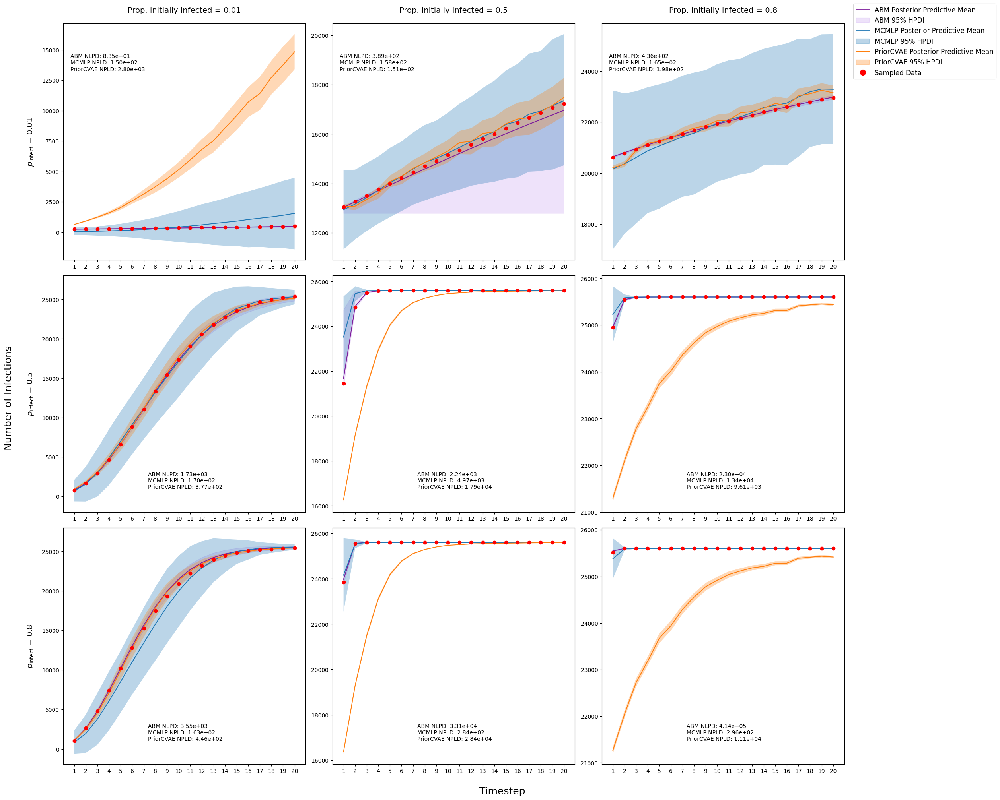

In [58]:
fig, axarr = plt.subplots(3,3,figsize=(25, 20))
nlpd_dict = {
    'abm':{k:v for k,v in zip(abm_posterior.keys(),g160_s20_metrics['NLPD']['abm'])},
    'mcmlp': {k:v for k,v in zip(abm_posterior.keys(),g160_s20_metrics['NLPD']['mcmlp'])},
    'priorcvae': {k:v for k,v in zip(abm_posterior.keys(),g160_s20_metrics['NLPD']['priorcvae'])},
}
for row,p_inf in enumerate([0.01,0.5, 0.8]):
    for col,prop_init_infected in enumerate([0.01,0.5,0.8]):
        axarr[row,col] =post_prediction_comparison(
            axarr[row,col],
            (p_inf,prop_init_infected),
            abm_posterior,
            surrogates_posterior,
            data,
            None, hpdi_alpha=0.3,
            show_legend=False,
            set_x_and_ylabels=False,
        ) 
        axarr[row,col].set_xticks(jnp.arange(0,20),jnp.arange(1,21))
        surrogate_nlpd_string = '\n'.join([f"{disp_name} NPLD: {nlpd_dict[surrogate_name][(p_inf,prop_init_infected)]:.2e}" for surrogate_name,disp_name in zip(['mcmlp','priorcvae'], 
                                                                                                                                               ['MCMLP', 'PriorCVAE'])])
        if row==0:
            text_x=0.03
            text_y=0.8
        else:
            text_x=0.35
            text_y =0.1
        axarr[row,col].annotate(
            f"ABM NLPD: {nlpd_dict['abm'][(p_inf,prop_init_infected)]:.2e}\n"+surrogate_nlpd_string,
            (text_x,text_y),
            xycoords='axes fraction'
            ) 

legend_handles=[]
for idx,color in enumerate([get_color_by_label(axarr[0,0],'ABM Posterior Predictive Mean'), 
            get_color_by_label(axarr[0,0],'ABM 95% HPDI'),
            get_color_by_label(axarr[0,0],'mcmlp Posterior Predictive Mean'),
            get_color_by_label(axarr[0,0],'mcmlp 95% HPDI'),
            get_color_by_label(axarr[0,0],'priorcvae Posterior Predictive Mean'),
            get_color_by_label(axarr[0,0],'priorcvae 95% HPDI')]):
    if idx%2==0:
        legend_handle = Line2D([0],[0],color=color,
                           linestyle='-',linewidth=2)
    else:
        legend_handle=mpatches.Patch(color=color)
    legend_handles.append(legend_handle)
legend_handles.append(Line2D([],[],color='None', marker='o',linestyle='None',markersize=10,
                             markerfacecolor='red',markeredgecolor='red'))

for idx,p_infect in enumerate([0.01, 0.5, 0.8]):
    axarr[idx, 0].set_ylabel(f'$p_{{\mathrm{{infect}}}}$ = {p_infect}', rotation=90, labelpad=20, va='center',fontsize=14)

for jdx, initial_infected in enumerate([0.01, 0.5, 0.8]):
    axarr[0,jdx].set_xlabel(f"Prop. initially infected = {initial_infected}",labelpad=20,fontsize=14)
    axarr[0, jdx].xaxis.set_label_position('top') 


fig.legend(handles=legend_handles, labels=['ABM Posterior Predictive Mean', 
                                           'ABM 95% HPDI', 
                                           'MCMLP Posterior Predictive Mean', 
                                           'MCMLP 95% HPDI',
                                           'PriorCVAE Posterior Predictive Mean', 
                                           'PriorCVAE 95% HPDI',
                                           'Sampled Data'],
           loc='upper right', bbox_to_anchor=(1, 1), bbox_transform=fig.transFigure,fontsize=12)
fig.supylabel('Number of Infections',fontsize=18,x=-0.001)
fig.supxlabel('Timestep',fontsize=18,y=-0.001)
# fig.suptitle('Comparison of ABM and surrogate posterior predictions across 100 combinations of prob_infect and initial_infected\nGrid Size 160 and Num Steps 20', 
#              y=1.01,fontsize=20)
plt.tight_layout(rect=[0, 0, 0.85, 1],h_pad=1,w_pad=1)
fig.savefig('../04_24_viz/g160_s20_preds.pdf')
plt.show()

In [16]:
del abm_posterior
del surrogates_posterior
del prior_predictions
del data
gc.collect()

11

## Performance

In [ ]:
s10_abm_means = [np.mean(g10_s10_abm_times), np.mean(g40_s10_abm_times),  np.mean(g160_s10_abm_times)]
s10_abm_percentiles = [[np.percentile(g10_s10_abm_times,2.5), np.percentile(g40_s10_abm_times,2.5),  np.percentile(g160_s10_abm_times,2.5)], 
                       [np.percentile(g10_s10_abm_times,97.5), np.percentile(g40_s10_abm_times,97.5),  np.percentile(g160_s10_abm_times,97.5)]]

s10_mcmlp_means = [np.mean(g10_s10_mcmlp_times), np.mean(g40_s10_mcmlp_times),  np.mean(g160_s10_mcmlp_times)]
s10_mcmlp_percentiles = [[np.percentile(g10_s10_mcmlp_times,2.5), np.percentile(g40_s10_mcmlp_times,2.5),  np.percentile(g160_s10_mcmlp_times,2.5)], 
                       [np.percentile(g10_s10_mcmlp_times,97.5), np.percentile(g40_s10_mcmlp_times,97.5),  np.percentile(g160_s10_mcmlp_times,97.5)]]

s10_priorcvae_means = [np.mean(g10_s10_priorcvae_times), np.mean(g40_s10_priorcvae_times),  np.mean(g160_s10_priorcvae_times)]
s10_priorcvae_percentiles = [[np.percentile(g10_s10_priorcvae_times,2.5), np.percentile(g40_s10_priorcvae_times,2.5),  np.percentile(g160_s10_priorcvae_times,2.5)], 
                       [np.percentile(g10_s10_priorcvae_times,97.5), np.percentile(g40_s10_priorcvae_times,97.5),  np.percentile(g160_s10_priorcvae_times,97.5)]]



s20_abm_means = [np.mean(g10_s20_abm_times), np.mean(g40_s20_abm_times),  np.mean(g160_s20_abm_times)]
s20_abm_percentiles = [[np.percentile(g10_s20_abm_times,2.5), np.percentile(g40_s20_abm_times,2.5),  np.percentile(g160_s20_abm_times,2.5)], 
                       [np.percentile(g10_s20_abm_times,97.5), np.percentile(g40_s20_abm_times,97.5),  np.percentile(g160_s20_abm_times,97.5)]]

s20_mcmlp_means = [np.mean(g10_s20_mcmlp_times), np.mean(g40_s20_mcmlp_times),  np.mean(g160_s20_mcmlp_times)]
s20_mcmlp_percentiles = [[np.percentile(g10_s20_mcmlp_times,2.5), np.percentile(g40_s20_mcmlp_times,2.5),  np.percentile(g160_s20_mcmlp_times,2.5)], 
                       [np.percentile(g10_s20_mcmlp_times,97.5), np.percentile(g40_s20_mcmlp_times,97.5),  np.percentile(g160_s20_mcmlp_times,97.5)]]

s20_priorcvae_means = [np.mean(g10_s20_priorcvae_times), np.mean(g40_s20_priorcvae_times),  np.mean(g160_s20_priorcvae_times)]
s20_priorcvae_percentiles = [[np.percentile(g10_s20_priorcvae_times,2.5), np.percentile(g40_s20_priorcvae_times,2.5),  np.percentile(g160_s20_priorcvae_times,2.5)], 
                       [np.percentile(g10_s20_priorcvae_times,97.5), np.percentile(g40_s20_priorcvae_times,97.5),  np.percentile(g160_s20_priorcvae_times,97.5)]]

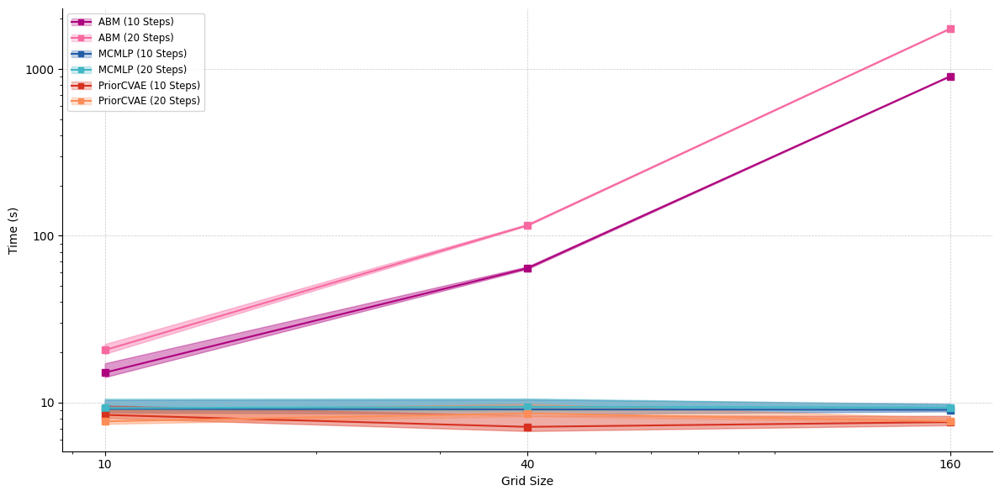

In [18]:
import matplotlib.pyplot as plt
import numpy as np # Assuming numpy is imported as np
import matplotlib.lines as mlines       # Import for Line2D
import matplotlib.patches as mpatches   # Import for Patch
from matplotlib.legend_handler import HandlerTuple # To handle tuple handles

# --- Assume your data variables exist here ---
# Using the same variable names as in your previous snippet
# s10_abm_means, s10_abm_percentiles, s20_abm_means, s20_abm_percentiles
# s10_mcmlp_means, s10_mcmlp_percentiles, s20_mcmlp_means, s20_mcmlp_percentiles
# s10_priorcvae_means, s10_priorcvae_percentiles, s20_priorcvae_means, s20_priorcvae_percentiles
# --- (End of assumed data) ---

# Define X axis details

grid_sizes = [10, 40, 160]
x_indices = grid_sizes#np.arange(len(grid_sizes)) # Should be [0, 1, 2]

# Define colors - using MORE DISTINCT shades per model
# ABM Colors (Purples)
color_abm_10 = '#ae017e'#'indigo'     # Shade 1 (Darker) for 10 steps
color_abm_20 = '#f768a1'#'violet'     # Shade 2 (Lighter) for 20 steps
# MCMLP Colors (Blues)
color_mcmlp_10 = '#225ea8'#'darkblue'     # Shade 1 (Darker) for 10 steps
color_mcmlp_20 = '#41b6c4' #'deepskyblue'  # Shade 2 (Lighter/Brighter) for 20 steps
# PriorCVAE Colors (Oranges)
color_priorcvae_10 = '#d7301f'#'orangered'    # Shade 1 ("Blood Orange" approx.) for 10 steps
color_priorcvae_20 = '#fc8d59'#'lightsalmon'  # Shade 2 (Light Orange) for 20 steps

# Define alpha for fill areas in the plot
plot_fill_alpha = 0.4

# Create figure and a single axes object
fig, ax = plt.subplots(1, 1, figsize=(12, 6)) # Single plot
ax.set_xscale('log')
# --- Plotting ---
# Removed 'label' argument, uncommented second fill_between calls
# Using line color with plot_fill_alpha for fill_between

# ABM Model
ax.plot(x_indices, s10_abm_means, color=color_abm_10, linestyle='-',marker='s')
ax.fill_between(x_indices, s10_abm_percentiles[0], s10_abm_percentiles[1], color=color_abm_10, alpha=plot_fill_alpha) # Fill using line color
ax.plot(x_indices, s20_abm_means, color=color_abm_20, linestyle='-',marker='s')
ax.fill_between(x_indices, s20_abm_percentiles[0], s20_abm_percentiles[1], color=color_abm_20, alpha=plot_fill_alpha) # Fill using line color

# MCMLP Model
ax.plot(x_indices, s10_mcmlp_means, color=color_mcmlp_10, linestyle='-',marker='s')
ax.fill_between(x_indices, s10_mcmlp_percentiles[0], s10_mcmlp_percentiles[1], color=color_mcmlp_10, alpha=plot_fill_alpha) # Fill using line color
ax.plot(x_indices, s20_mcmlp_means, color=color_mcmlp_20, linestyle='-',marker='s')
ax.fill_between(x_indices, s20_mcmlp_percentiles[0], s20_mcmlp_percentiles[1], color=color_mcmlp_20, alpha=plot_fill_alpha) # Fill using line color

# PriorCVAE Model
ax.plot(x_indices, s10_priorcvae_means, color=color_priorcvae_10, linestyle='-',marker='s')
ax.fill_between(x_indices, s10_priorcvae_percentiles[0], s10_priorcvae_percentiles[1], color=color_priorcvae_10, alpha=plot_fill_alpha) # Fill using line color
ax.plot(x_indices, s20_priorcvae_means, color=color_priorcvae_20, linestyle='-',marker='s')
ax.fill_between(x_indices, s20_priorcvae_percentiles[0], s20_priorcvae_percentiles[1], color=color_priorcvae_20, alpha=plot_fill_alpha) # Fill using line color


# --- Create Custom Legend Handles and Labels ---
legend_handles = []
legend_labels = []
line_lw = 1.5         # Linewidth for legend lines
legend_fill_alpha = 0.25 # Alpha for legend patches (as per your example)
markersize = 4

# ABM 10 Steps
line10_abm = mlines.Line2D([0], [0], color=color_abm_10, linestyle='-', linewidth=line_lw, marker='s', markersize=markersize)
patch10_abm = mpatches.Patch(color=color_abm_10, alpha=legend_fill_alpha) # Patch uses line color
legend_handles.append((line10_abm, patch10_abm))
legend_labels.append('ABM (10 Steps)')

# ABM 20 Steps
line20_abm = mlines.Line2D([0], [0], color=color_abm_20, linestyle='-', linewidth=line_lw, marker='s', markersize=markersize)
patch20_abm = mpatches.Patch(color=color_abm_20, alpha=legend_fill_alpha) # Patch uses line color
legend_handles.append((line20_abm, patch20_abm))
legend_labels.append('ABM (20 Steps)')

# MCMLP 10 Steps
line10_mcmlp = mlines.Line2D([0], [0], color=color_mcmlp_10, linestyle='-', linewidth=line_lw, marker='s', markersize=markersize)
patch10_mcmlp = mpatches.Patch(color=color_mcmlp_10, alpha=legend_fill_alpha) # Patch uses line color
legend_handles.append((line10_mcmlp, patch10_mcmlp))
legend_labels.append('MCMLP (10 Steps)')

# MCMLP 20 Steps
line20_mcmlp = mlines.Line2D([0], [0], color=color_mcmlp_20, linestyle='-', linewidth=line_lw, marker='s', markersize=markersize)
patch20_mcmlp = mpatches.Patch(color=color_mcmlp_20, alpha=legend_fill_alpha) # Patch uses line color
legend_handles.append((line20_mcmlp, patch20_mcmlp))
legend_labels.append('MCMLP (20 Steps)')

# PriorCVAE 10 Steps
line10_priorcvae = mlines.Line2D([0], [0], color=color_priorcvae_10, linestyle='-', linewidth=line_lw, marker='s', markersize=markersize)
patch10_priorcvae = mpatches.Patch(color=color_priorcvae_10, alpha=legend_fill_alpha) # Patch uses line color
legend_handles.append((line10_priorcvae, patch10_priorcvae))
legend_labels.append('PriorCVAE (10 Steps)')

# PriorCVAE 20 Steps
line20_priorcvae = mlines.Line2D([0], [0], color=color_priorcvae_20, linestyle='-', linewidth=line_lw, marker='s', markersize=markersize)
patch20_priorcvae = mpatches.Patch(color=color_priorcvae_20, alpha=legend_fill_alpha) # Patch uses line color
legend_handles.append((line20_priorcvae, patch20_priorcvae))
legend_labels.append('PriorCVAE (20 Steps)')

# --- Axis configuration ---
ax.set_yscale('log')
ax.set_xticks(x_indices)
ax.set_xticklabels(grid_sizes)
# ax.set_xlim(-0.05,None)
ax.set_yticks([1e1, 1e2, 1e3],[10, 100, 1000])
ax.set_xlabel('Grid Size')
ax.set_ylabel('Time (s)')
#ax.set_title('Model MCMC Time Comparison (10 vs 20 Steps)')

# Disable top and right spines (as requested)
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)

# Add grid (as requested)
ax.grid(True, linestyle='--', linewidth=0.5, alpha=0.7)

# --- Legend ---
# Place the custom legend on the axes
ax.legend(handles=legend_handles, labels=legend_labels,
          #handler_map={tuple: HandlerTuple(ndivide=None, pad=0.2)}, # Use HandlerTuple
          loc='best', fontsize='small') # Adjust loc and fontsize as needed

# --- Layout and Display ---
plt.tight_layout() # Adjust layout
fig.savefig('../04_24_viz/time_per_infer.pdf')
plt.show() # Display the plot

In [20]:
with open('../04_24_viz/g10_s10_metrics.pkl','rb') as f:
    g10_s10_metrics = pickle.load(f)

with open('../04_24_viz/g10_s20_metrics.pkl','rb') as f:
    g10_s20_metrics = pickle.load(f)

with open('../04_24_viz/g40_s10_metrics.pkl','rb') as f:
    g40_s10_metrics = pickle.load(f)

with open('../04_24_viz/g40_s20_metrics.pkl','rb') as f:
    g40_s20_metrics = pickle.load(f)

with open('../04_24_viz/g160_s10_metrics.pkl','rb') as f:
    g160_s10_metrics = pickle.load(f)

with open('../04_24_viz/g160_s20_metrics.pkl','rb') as f:
    g160_s20_metrics = pickle.load(f)

# Posterior Means 

In [21]:
for metric_name,metric in zip(['g10_s10','g10_s20', 
                               'g40_s10', 'g40_s20', 'g160_s10','g160_s20'],
                               [g10_s10_metrics, g10_s20_metrics, g40_s10_metrics, 
                                g40_s20_metrics,g160_s10_metrics, g160_s20_metrics]):
    mcmlp_mses = jnp.square(metric['posterior_mean']['abm'] - metric['posterior_mean']['mcmlp'])
    priorcvae_mses = jnp.square(metric['posterior_mean']['abm'] - metric['posterior_mean']['priorcvae'])
    print(f"MCMLP {metric_name}: {jnp.mean(mcmlp_mses):.3f} +- {jnp.std(mcmlp_mses):.3f}")
    print(f"PriorCVAE {metric_name}: {jnp.mean(priorcvae_mses):.3f} +- {jnp.std(priorcvae_mses):.3f}")
    print()

MCMLP g10_s10: 0.006 +- 0.013
PriorCVAE g10_s10: 0.067 +- 0.140

MCMLP g10_s20: 0.010 +- 0.020
PriorCVAE g10_s20: 0.136 +- 0.204

MCMLP g40_s10: 0.004 +- 0.009
PriorCVAE g40_s10: 0.066 +- 0.130

MCMLP g40_s20: 0.022 +- 0.035
PriorCVAE g40_s20: 0.098 +- 0.157

MCMLP g160_s10: 0.007 +- 0.008
PriorCVAE g160_s10: 0.127 +- 0.160

MCMLP g160_s20: 0.018 +- 0.022
PriorCVAE g160_s20: 0.162 +- 0.222



## 1-Wassersteins

In [22]:
for metric_name,metric in zip(['g10_s10','g10_s20', 
                               'g40_s10', 'g40_s20', 'g160_s10','g160_s20'],
                               [g10_s10_metrics, g10_s20_metrics, g40_s10_metrics, 
                                g40_s20_metrics,g160_s10_metrics, g160_s20_metrics]):
    print(f"{jnp.mean(metric['1_wasserstein']['mcmlp']):.3f} vs {jnp.mean(metric['1_wasserstein']['priorcvae']):.3f}")
    print()

0.050 vs 0.160

0.065 vs 0.257

0.042 vs 0.155

0.109 vs 0.208

0.067 vs 0.258

0.101 vs 0.280



## NLPDS

In [23]:
for metric_name,metric in zip(['g10_s10','g10_s20', 
                               'g40_s10', 'g40_s20', 'g160_s10','g160_s20'],
                               [g10_s10_metrics, g10_s20_metrics, g40_s10_metrics, 
                                g40_s20_metrics,g160_s10_metrics, g160_s20_metrics]):
    print(10*'='+metric_name+'='*10)
    print(f"MCMLP mean {jnp.mean(metric['NLPD']['mcmlp']):.2e}" 
          f" vs PriorCVAE mean {jnp.mean(metric['NLPD']['priorcvae']):.2e}"
          f" vs ABM mean {jnp.mean(metric['NLPD']['abm']):.2e}")
    mcmlp_at_least_as_low = metric['NLPD']['mcmlp']<=metric['NLPD']['abm']
    priorcvae_at_least_as_low = metric['NLPD']['priorcvae']<=metric["NLPD"]['abm']
    print(f"NLPDS at least as low: MCMLP {jnp.sum(mcmlp_at_least_as_low)} vs PriorCVAE {jnp.sum(priorcvae_at_least_as_low)}")
    
#     print(f"MCMLP wins {jnp.sum(jnp.logical_and(metric['NLPD']['mcmlp']<metric['NLPD']['priorcvae'],metric['NLPD']['mcmlp']<metric['NLPD']['abm']))}"
#           f" vs PriorCVAE wins {jnp.sum(jnp.logical_and(metric['NLPD']['priorcvae']<metric['NLPD']['mcmlp'], metric['NLPD']['priorcvae']<metric['NLPD']['abm']))}"
#           f" vs ABM wins {jnp.sum(jnp.logical_and(metric['NLPD']['abm']  < metric['NLPD']['mcmlp'], metric['NLPD']['abm']<metric['NLPD']['priorcvae']))}")
    print()

==========g10_s10==========
MCMLP mean 2.76e+04 vs PriorCVAE mean 9.50e+03 vs ABM mean 5.84e+09
NLPDS at least as low: MCMLP 46 vs PriorCVAE 15

==========g10_s20==========
MCMLP mean 1.23e+07 vs PriorCVAE mean 4.97e+03 vs ABM mean 1.47e+10
NLPDS at least as low: MCMLP 50 vs PriorCVAE 31

==========g40_s10==========
MCMLP mean 3.92e+03 vs PriorCVAE mean 1.43e+04 vs ABM mean 1.05e+08
NLPDS at least as low: MCMLP 79 vs PriorCVAE 8

==========g40_s20==========
MCMLP mean 8.38e+06 vs PriorCVAE mean 3.14e+03 vs ABM mean 1.28e+08
NLPDS at least as low: MCMLP 51 vs PriorCVAE 12

==========g160_s10==========
MCMLP mean 5.74e+02 vs PriorCVAE mean 2.59e+04 vs ABM mean 7.91e+04
NLPDS at least as low: MCMLP 8 vs PriorCVAE 6

==========g160_s20==========
MCMLP mean 2.20e+03 vs PriorCVAE mean 7.89e+03 vs ABM mean 5.32e+04
NLPDS at least as low: MCMLP 7 vs PriorCVAE 7

